# Carregar bibliotecas e configurar ambiente

## Importar Bibliotecas

In [53]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.model_selection import cross_val_predict, train_test_split, RandomizedSearchCV

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor



from sklearn. feature_selection import SelectKBest
from sklearn. feature_selection import f_regression

In [54]:
import warnings

warnings.filterwarnings("ignore", category=UserWarning)

## Configurar Ambiente

In [55]:
# Configuração do ambiente

# Mostra todas as colunas na visualização
pd.set_option('display.max_columns', None)

# Configurando Para Mostrar 2 Casas Decimais
pd.set_option('display.float_format', '{:.6f}'.format)

In [56]:
# pd.reset_option('^display.', silent=True)

# Carregar Dados

## Carregar dados pelo Jupyter PC

In [57]:
# Carregar dados de treino
df=pd.read_csv('dataset/train.csv')

# Carregar Dados de Teste
df_teste=pd.read_csv('dataset/test.csv')

# Os dados não serão utilizados no treino.
# Serão avaliados os possíveis tratamentos para evitar problemas ao submeter a solução no Kaggle.

C:\Users\terce\AppData\Local\Temp\ipykernel_20484\3022644176.py:2: DtypeWarning: Columns (0,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('dataset/train.csv')
C:\Users\terce\AppData\Local\Temp\ipykernel_20484\3022644176.py:5: DtypeWarning: Columns (0,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51) have mixed types. Specify dtype option on import or set low_memory=False.
  df_teste=pd.read_csv('dataset/test.csv')


## Carregar dados pelo Notebook Kaggle

In [58]:
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [59]:
# Upload data
# df=pd.read_csv('/kaggle/input/predict-the-wind-speed-at-a-wind-turbine/train.csv')
# df_test=pd.read_csv('/kaggle/input/predict-the-wind-speed-at-a-wind-turbine/test.csv')

## Carregar dados pelo Google Colab

In [60]:
# Baixar a dataset compartilhado publicamente no google drive utilizando o GDOWN
# !gdown 1NOt5sXfFyQ5boIcSQhafAO014zcZ4I7t

In [61]:
# pip install kaggle -q

In [62]:
# !mkdir -p ~/.kaggle

In [63]:
# !cp kaggle.json ~/.kaggle

In [64]:
# !chmod 600 ~/.kaggle/kaggle.json

In [65]:
# !kaggle datasets list

In [66]:
# %cd /content/

# !kaggle competitions download -c predict-the-wind-speed-at-a-wind-turbine

In [67]:
# !unzip predict-the-wind-speed-at-a-wind-turbine.zip

In [68]:
# Upload data
# df_bkup=pd.read_csv('/content/train.csv')
# df_teste=pd.read_csv('/content/test.csv')

# Análise Exploratória dos Dados (EDA)

## Formatar Dados

In [69]:
df.head()

,Unnamed: 0,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,training,target_feature
0,Turbine,NaN,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,NaN,NaN
1,id,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,2017-10-01 00:00:00,9.112874984741213,9.197829246520996,8.795919418334961,8.749383926391602,7.6849541664123535,1.104222059249878,1.0966191291809082,0.9995877146720886,1.1921913623809814,1.290310621261597,166.33880615234375,171.0978546142578,166.75782775878906,167.4920196533203,167.5775909423828,171.4622802734375,174.63275146484375,164.43544006347656,159.97628784179688,170.3399658203125,5.684341886080803e-14,0.0,0.4068910181522369,0.0,5.684341886080803e-14,-5.900864601135254,-4.05055570602417,1.2627402544021606,6.251605987548828,-5.537933826446533,1484.768310546875,1386.177734375,1277.0732421875,1129.3673095703125,850.0106811523438,12.899999618530272,12.949999809265137,13.300000190734863,12.4975004196167,13.829999923706056,1793.2969970703125,1780.7293701171875,1768.215087890625,1733.296875,1603.7493896484375,0.1834866404533386,0.1354895979166031,0.0010526315309107,0.0,0.0,True,8.602844
3,1,2017-10-01 00:10:00,8.319863319396973,9.350296020507812,8.762059211730957,8.652318000793457,7.421575546264648,1.2076553106307983,0.9166100025177002,0.956899106502533,1.4913365840911863,1.180193305015564,170.76556396484375,171.52635192871094,170.17349243164062,167.3640899658203,167.27706909179688,171.4622802734375,174.63275146484375,164.5568084716797,159.97628784179688,170.3399658203125,5.684341886080803e-14,0.0,0.5012629628181458,0.0,5.684341886080803e-14,-2.4897220134735107,-2.2814981937408447,4.499786853790283,4.683475017547607,-1.2760701179504397,1261.810546875,1488.69091796875,1327.401611328125,1253.022216796875,810.9736328125,12.899999618530272,12.934999465942385,13.300000190734863,12.5,13.802499771118164,1755.418701171875,1793.579345703125,1770.806884765625,1737.21826171875,1572.7694091796875,0.0519975572824478,0.0869988277554512,0.0959980711340904,0.0604995340

In [70]:
df_teste.head()

,Unnamed: 0,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
0,Turbine,NaN,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6,Kelmarsh 2,Kelmarsh 3,Kelmarsh 4,Kelmarsh 5,Kelmarsh 6
1,id,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2016,2017-10-15 00:00:00,9.410975456237791,8.906447410583496,8.516111373901367,6.889415740966797,7.907522678375244,0.8277542591094971,0.760050356388092,0.4532543420791626,0.9713202118873596,0.582650363445282,178.74542236328125,179.39051818847656,175.6776580810547,172.0289306640625,172.89830017089844,168.16958618164062,175.73031616210938,179.56161499023438,166.56167602539062,175.82778930664062,0.0,0.0,0.0,0.0,0.0,9.813562393188477,1.023783802986145,-4.427249431610107,9.815627098083496,-1.8744758367538448,1504.3084716796875,1255.0582275390625,1082.2562255859375,700.8784790039062,902.56591796875,13.9399995803833,13.59000015258789,13.977499961853027,13.154999732971191,14.234999656677246,1794.619384765625,1792.0416259765625,1737.6014404296875,1528.9410400390625,1653.4169921875,0.0074999928474426,0.0,0.0,0.0,0.0
3,2017,2017-10-15 00:10:00,9.313236236572266,9.432559967041016,9.133708000183104,6.192321300506592,8.215789794921875,1.0743610858917236,0.8983492851257324,0.5329716205596924,0.9643114805221558,0.3891542553901672,180.8585052490234,181.23200988769523,177.8720703125,179.6746063232422,178.44137573242188,175.08836364746094,175.73031616210938,179.56161499023438,170.27349853515625,175.82778930664062,4.526707649230957,0.0,0.0,3.7524125576019287,0.0,3.500461339950561,5.471498966217041,-4.201434135437012,11.366840362548828,1.854399800300598,1587.863037109375,1594.5189208984375,1477.232177734375,565.27880859375,1039.8232421875,13.75,13.470000267028809,13.91249942779541,12.989999771118164,14.179999351501465,1794.2451171875,1795.033935546875,1789.427734375,1420.3548583984375,1730.60302734375,0.0,0.0,0.0,0.0,0.0
4,2018,2017-10-15 00:20:00,9.726503372192385,9.917057991027832,9.37641429901123,6.01415491104126,8.579672813415527,0.9379878640174866,0.6028102040290833,0.5194037556648254,0.7202718257904053,0.61

OBS: As 2 primeiras linhas também possuem informações do cabeçalho. Será necessário retirá-las e redefinir um cabeçalho.

In [71]:
# Função para corrigir colunas e índice
def correction_columns(data):

    # Retirar as duas primeiras linhas referentes ao cabeçalho
    data= data.drop([0,1])

    # Alterar o nome da coluna 1 para "id"
    new_name_columns = list(data.columns)
    new_name_columns[0] = 'id'
    data.columns = new_name_columns

    # Tornar coluna 'id' com index
    data = data.set_index('id')

    return data

In [72]:
df = correction_columns(df)
df.head()

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,training,target_feature
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2017-10-01 00:00:00,9.112874984741213,9.197829246520996,8.795919418334961,8.749383926391602,7.6849541664123535,1.104222059249878,1.0966191291809082,0.9995877146720886,1.1921913623809814,1.290310621261597,166.33880615234375,171.0978546142578,166.75782775878906,167.4920196533203,167.5775909423828,171.4622802734375,174.63275146484375,164.43544006347656,159.97628784179688,170.3399658203125,5.684341886080803e-14,0.0,0.4068910181522369,0.0,5.684341886080803e-14,-5.900864601135254,-4.05055570602417,1.2627402544021606,6.251605987548828,-5.537933826446533,1484.768310546875,1386.177734375,1277.0732421875,1129.3673095703125,850.0106811523438,12.899999618530272,12.949999809265137,13.300000190734863,12.4975004196167,13.829999923706056,1793.2969970703125,1780.7293701171875,1768.215087890625,1733.296875,1603.7493896484375,0.1834866404533386,0.1354895979166031,0.0010526315309107,0.0,0.0,True,8.602844
1,2017-10-01 00:10:00,8.319863319396973,9.350296020507812,8.762059211730957,8.652318000793457,7.421575546264648,1.2076553106307983,0.9166100025177002,0.956899106502533,1.4913365840911863,1.180193305015564,170.76556396484375,171.52635192871094,170.17349243164062,167.3640899658203,167.27706909179688,171.4622802734375,174.63275146484375,164.5568084716797,159.97628784179688,170.3399658203125,5.684341886080803e-14,0.0,0.5012629628181458,0.0,5.684341886080803e-14,-2.4897220134735107,-2.2814981937408447,4.499786853790283,4.683475017547607,-1.2760701179504397,1261.810546875,1488.69091796875,1327.401611328125,1253.022216796875,810.9736328125,12.899999618530272,12.934999465942385,13.300000190734863,12.5,13.802499771118164,1755.418701171875,1793.579345703125,1770.806884765625,1737.21826171875,1572.7694091796875,0.0519975572824478,0.0869988277554512,0.0959980711340904,0.0604995340108871,0.0,True,8.125226
2,2017-10-01 00:20:00,8.799176216125488,8.510401725769043,9.533565521240234,8.166585922241211,7.79703950881958,1.124028563499451,0.992840588092804,1.3431802988052368,1.6383079290390017,1.3427436351776123,171.25563049316406,178.154541015625,175.37222290039062,172.82298278808594,172.0786895751953,171.4622802734375,174.63275146484375,177.2129364013672,175.25962829589844,170.3399658203125,5.684341886080803e-14,0.0,5.334985256195068,6.9234161376953125,5.684341886080803e-14,3.080551862716675,1.4655344486236572,-2.817413330078125,-2.942854166030884,4.030418872833252,1386.6669921875,1332.8057861328125,1403.7171630859375,1125.091552734375,1032.624267578125,12.934999465942385,12.920000076293944,13.300000190734863,12.5,13.80

In [73]:
df_teste = correction_columns(df_teste)
df_teste.head()

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016,2017-10-15 00:00:00,9.410975456237791,8.906447410583496,8.516111373901367,6.889415740966797,7.907522678375244,0.8277542591094971,0.760050356388092,0.4532543420791626,0.9713202118873596,0.582650363445282,178.74542236328125,179.39051818847656,175.6776580810547,172.0289306640625,172.89830017089844,168.16958618164062,175.73031616210938,179.56161499023438,166.56167602539062,175.82778930664062,0.0,0.0,0.0,0.0,0.0,9.813562393188477,1.023783802986145,-4.427249431610107,9.815627098083496,-1.8744758367538448,1504.3084716796875,1255.0582275390625,1082.2562255859375,700.8784790039062,902.56591796875,13.9399995803833,13.59000015258789,13.977499961853027,13.154999732971191,14.234999656677246,1794.619384765625,1792.0416259765625,1737.6014404296875,1528.9410400390625,1653.4169921875,0.0074999928474426,0.0,0.0,0.0,0.0
2017,2017-10-15 00:10:00,9.313236236572266,9.432559967041016,9.133708000183104,6.192321300506592,8.215789794921875,1.0743610858917236,0.8983492851257324,0.5329716205596924,0.9643114805221558,0.3891542553901672,180.8585052490234,181.23200988769523,177.8720703125,179.6746063232422,178.44137573242188,175.08836364746094,175.73031616210938,179.56161499023438,170.27349853515625,175.82778930664062,4.526707649230957,0.0,0.0,3.7524125576019287,0.0,3.500461339950561,5.471498966217041,-4.201434135437012,11.366840362548828,1.854399800300598,1587.863037109375,1594.5189208984375,1477.232177734375,565.27880859375,1039.8232421875,13.75,13.470000267028809,13.91249942779541,12.989999771118164,14.179999351501465,1794.2451171875,1795.033935546875,1789.427734375,1420.3548583984375,1730.60302734375,0.0,0.0,0.0,0.0,0.0
2018,2017-10-15 00:20:00,9.726503372192385,9.917057991027832,9.37641429901123,6.01415491104126,8.579672813415527,0.9379878640174866,0.6028102040290833,0.5194037556648254,0.7202718257904053,0.6149343252182007,181.46597290039065,185.40629577636716,179.66529846191406,187.00524902343744,179.46278381347656,178.04766845703125,176.49378967285156,179.56161499023438,174.24462890625,175.82778930664062,0.0,2.8851590156555176,0.0,0.0,0.0,5.362265586853027,8.677570343017578,0.0232390947639942,8.275834083557129,3.6965391635894775,1576.585693359375,1593.1038818359375,1502.9432373046875,505.5481567382813,1122.5509033203125,13.484999656677246,13.234999656677246,13.730000495910645,12.907499313354492,14.00749969482422,1796.7752685546875,1795.225830078125,1789.70703125,1382.7603759765625,1764.00341796875,0.0314997360110282,0.0,0.0,0.0,0.0
2019,2017-10-15 00:30:00,8.560906410217285,9.248798370361328,8.932862281799316,5.859115123748779,8

In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 130608 entries, 0 to 195119
Data columns (total 53 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   Timestamp                                   130608 non-null  object 
 1   Wind speed (m/s)                            129454 non-null  object 
 2   Wind speed (m/s).1                          100652 non-null  object 
 3   Wind speed (m/s).2                          129444 non-null  object 
 4   Wind speed (m/s).3                          129256 non-null  object 
 5   Wind speed (m/s).4                          129366 non-null  object 
 6   Wind speed, Standard deviation (m/s)        129200 non-null  object 
 7   Wind speed, Standard deviation (m/s).1      100398 non-null  object 
 8   Wind speed, Standard deviation (m/s).2      129190 non-null  object 
 9   Wind speed, Standard deviation (m/s).3      129003 non-null  object 
 10  W

In [75]:
df_teste.info()

<class 'pandas.core.frame.DataFrame'>
Index: 64512 entries, 2016 to 193535
Data columns (total 51 columns):
 #   Column                                      Non-Null Count  Dtype 
---  ------                                      --------------  ----- 
 0   Timestamp                                   64512 non-null  object
 1   Wind speed (m/s)                            63265 non-null  object
 2   Wind speed (m/s).1                          48825 non-null  object
 3   Wind speed (m/s).2                          63280 non-null  object
 4   Wind speed (m/s).3                          63256 non-null  object
 5   Wind speed (m/s).4                          63292 non-null  object
 6   Wind speed, Standard deviation (m/s)        63265 non-null  object
 7   Wind speed, Standard deviation (m/s).1      48825 non-null  object
 8   Wind speed, Standard deviation (m/s).2      63280 non-null  object
 9   Wind speed, Standard deviation (m/s).3      63256 non-null  object
 10  Wind speed, Standard de

In [76]:
# Separando a coluna de target
df_target = df['target_feature']
df_target = df_target.astype(float)

# Removendo a coluna de target do dataset
df.drop('target_feature', axis=1, inplace=True)

In [77]:
df_target.info()

<class 'pandas.core.series.Series'>
Index: 130608 entries, 0 to 195119
Series name: target_feature
Non-Null Count   Dtype  
--------------   -----  
129413 non-null  float64
dtypes: float64(1)
memory usage: 2.0+ MB


In [78]:
df_target.head()

id
0   8.602844
1   8.125226
2   7.551986
3   7.912114
4   7.776817
Name: target_feature, dtype: float64

In [79]:
# Tratanto e Classificando as colunas

# Como essa coluna não tem informação útil, será removida.
df.drop('training', axis=1, inplace=True)

# Colunas temporais
df_columns_temp = ['Timestamp']

# Colunas numéricas (float) do dataframe
df_columns_num = [item for item in list(df.columns) if item not in set(df_columns_temp)]

list_angle = ['Wind direction (°)',
       'Wind direction (°).1', 'Wind direction (°).2', 'Wind direction (°).3',
       'Wind direction (°).4', 'Nacelle position (°)',
       'Nacelle position (°).1', 'Nacelle position (°).2',
       'Nacelle position (°).3', 'Nacelle position (°).4',
       'Nacelle position, Standard deviation (°)',
       'Nacelle position, Standard deviation (°).1',
       'Nacelle position, Standard deviation (°).2',
       'Nacelle position, Standard deviation (°).3',
       'Nacelle position, Standard deviation (°).4', 'Vane position 1+2 (°)',
       'Vane position 1+2 (°).1', 'Vane position 1+2 (°).2',
       'Vane position 1+2 (°).3', 'Vane position 1+2 (°).4', 
       'Blade angle (pitch position) A (°)',
       'Blade angle (pitch position) A (°).1',
       'Blade angle (pitch position) A (°).2',
       'Blade angle (pitch position) A (°).3',
       'Blade angle (pitch position) A (°).4']

In [80]:
# Formatando as colunas

# Função para corrigir colunas e índice
def trat_columns(data):

    # Formatar a coluna "Timestamp" como tipo de dado datetime com data e hora
    data['Timestamp'] = pd.to_datetime(data['Timestamp'],format='%Y-%m-%d %H:%M:%S')

    # Formatar coluna em dados tipo float
    data[df_columns_num] = data[df_columns_num].astype(float)
    

    return data




In [81]:
df = trat_columns(df)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 130608 entries, 0 to 195119
Data columns (total 51 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   Timestamp                                   130608 non-null  datetime64[ns]
 1   Wind speed (m/s)                            129454 non-null  float64       
 2   Wind speed (m/s).1                          100652 non-null  float64       
 3   Wind speed (m/s).2                          129444 non-null  float64       
 4   Wind speed (m/s).3                          129256 non-null  float64       
 5   Wind speed (m/s).4                          129366 non-null  float64       
 6   Wind speed, Standard deviation (m/s)        129200 non-null  float64       
 7   Wind speed, Standard deviation (m/s).1      100398 non-null  float64       
 8   Wind speed, Standard deviation (m/s).2      129190 non-null  float64       
 9 

In [82]:
df_teste = trat_columns(df_teste)
df_teste.info()

<class 'pandas.core.frame.DataFrame'>
Index: 64512 entries, 2016 to 193535
Data columns (total 51 columns):
 #   Column                                      Non-Null Count  Dtype         
---  ------                                      --------------  -----         
 0   Timestamp                                   64512 non-null  datetime64[ns]
 1   Wind speed (m/s)                            63265 non-null  float64       
 2   Wind speed (m/s).1                          48825 non-null  float64       
 3   Wind speed (m/s).2                          63280 non-null  float64       
 4   Wind speed (m/s).3                          63256 non-null  float64       
 5   Wind speed (m/s).4                          63292 non-null  float64       
 6   Wind speed, Standard deviation (m/s)        63265 non-null  float64       
 7   Wind speed, Standard deviation (m/s).1      48825 non-null  float64       
 8   Wind speed, Standard deviation (m/s).2      63280 non-null  float64       
 9   Wind sp

## Detectar valores nulos

In [83]:
#Função para visualização de valores ausentes

def nan_verification(data):
    # Detectar valores nulos com porcentagens
    # data = df
    count_nan = pd.DataFrame(data.isna().sum(),columns=['Count'])
    count_nan['Perc'] = count_nan['Count']/len(data)*100
    count_nan = count_nan.sort_values(by='Perc', ascending=False)
    return count_nan


In [84]:
# Criando df com timestamp e quantidade de valores ausentes por linha
def nan_verification_graph(data):
    dist_ausentes_teste = pd.DataFrame({
        'Timestamp': data['Timestamp'],
        'Valores_Ausentes': data.isna().sum(axis=1)
    }, index=data.index)

    plt.figure(figsize=(15,5))
    plt.plot(dist_ausentes_teste.iloc[:,0], dist_ausentes_teste.iloc[:,1])
    plt.xlabel(dist_ausentes_teste.columns[0])
    plt.ylabel(dist_ausentes_teste.columns[1])
    plt.title('Distribuição de valores ausentes')
    #plt.legend()
    plt.show()

### Dados de Treino

In [85]:
nan_verification(df)

,Count,Perc
"Wind speed, Standard deviation (m/s).1",30210,23.130283
Blade angle (pitch position) A (°).1,30197,23.120330
Vane position 1+2 (°).1,30196,23.119564
Nacelle ambient temperature (°C).1,30196,23.119564
"Nacelle position, Standard deviation (°).1",30023,22.987106
Wind speed (m/s).1,29956,22.935808
Power (kW).1,29770,22.793397
Wind direction (°).1,29769,22.792631
Nacelle position (°).1,29769,22.792631
Generator RPM (RPM).1,29769,22.792631


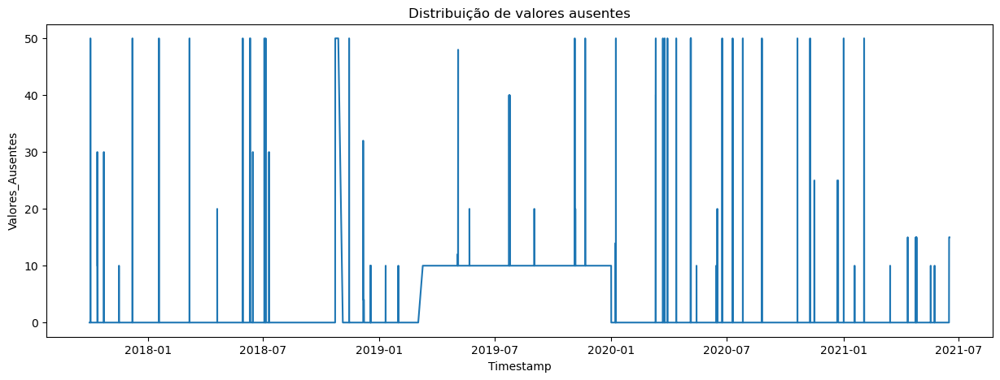

In [86]:
nan_verification_graph(df)

### Dados de Teste

In [87]:
nan_verification(df_teste)

,Count,Perc
Power (kW).1,15688,24.317956
Vane position 1+2 (°).1,15688,24.317956
Nacelle ambient temperature (°C).1,15688,24.317956
Blade angle (pitch position) A (°).1,15688,24.317956
Generator RPM (RPM).1,15688,24.317956
Wind direction (°).1,15687,24.316406
Wind speed (m/s).1,15687,24.316406
Nacelle position (°).1,15687,24.316406
"Wind speed, Standard deviation (m/s).1",15687,24.316406
"Nacelle position, Standard deviation (°).1",15687,24.316406


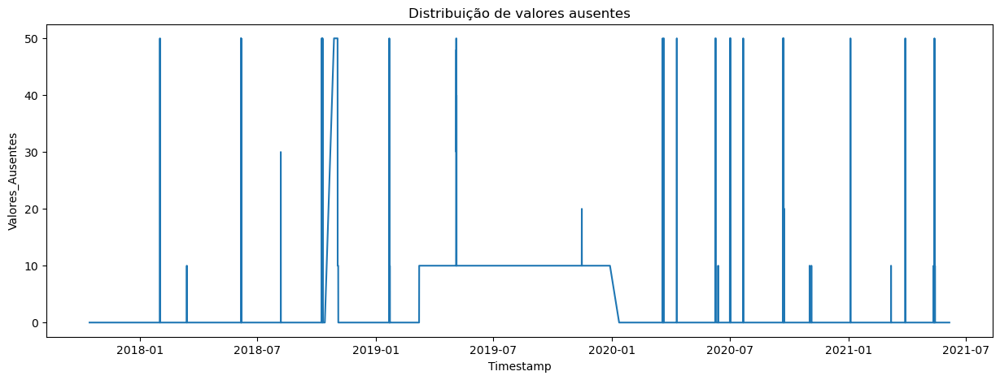

In [88]:
nan_verification_graph(df_teste)

### Dados Target

In [89]:
# Valores ausentes na coluna de target

df_target.isna().sum()

1195

In [90]:
df['target_feature'] = df_target

In [91]:
# Retirando valores ausentes da coluna de target
df = df.dropna(subset=['target_feature'])

In [92]:
len(df)

129413

Duas abordagens serão seguidas:
- Para a região em 2019 com aproximadamente 23% de dados ausentes referente a turbina Kelmarsh 3, as linhas serão preenchidas;
- Para os picos, represetando menos de 2% doa dados, as linhas serão deletadas;

## Analisar variáveis categóricas - Balanceamento de classes

In [93]:
# Variáveis categóricas
# df[df_columns_cat].value_counts()

# Não há variáveis categóricas

## Analisar variáveis temporais - Visualizações temporais

In [94]:
# Verificar a duração da pesquisa
print(df['Timestamp'].min())
print(df['Timestamp'].max())
print(df['Timestamp'].max() - df['Timestamp'].min())

2017-10-01 00:00:00
2021-06-16 23:50:00
1354 days 23:50:00


In [95]:
# Função para criar novas colunas com mês, dia e hora
def tempo(data):
    data['mes'] = data['Timestamp'].dt.month
    data['dia'] = data['Timestamp'].dt.day
    data['hora'] = data['Timestamp'].dt.hour
    return data

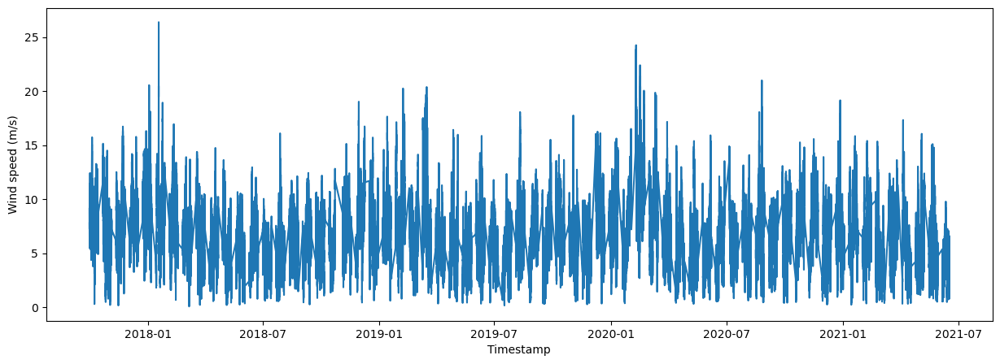

In [111]:
plt.figure(figsize=(15,5))
plt.plot(df.iloc[:,0], df.iloc[:,1])
plt.xlabel(df.columns[0])
plt.ylabel(df.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.show()

In [96]:
list_time = ['mes', 'dia', 'hora']
df = tempo(df)

In [97]:
df['mes'].value_counts()

5     12293
12    12232
3     12176
10    11807
1     11496
4     11086
11    11018
2     10761
6      9810
7      9207
9      8784
8      8743
Name: mes, dtype: int64

In [98]:
9961-6970

2991

In [99]:
df['dia'].value_counts()

6     4896
4     4721
27    4608
14    4601
25    4547
16    4464
12    4462
8     4459
17    4320
15    4319
2     4279
10    4248
5     4232
23    4184
1     4176
13    4176
22    4175
26    4175
9     4175
21    4175
3     4172
7     4166
24    4032
28    4032
19    4032
18    4015
11    3932
20    3880
29    3876
30    3436
31    2448
Name: dia, dtype: int64

In [100]:
df['hora'].value_counts()

0     5408
17    5406
22    5406
21    5406
19    5406
18    5406
20    5405
23    5405
1     5399
2     5398
16    5396
7     5396
6     5394
5     5394
3     5394
4     5393
8     5390
9     5381
10    5381
15    5378
13    5370
14    5369
11    5366
12    5366
Name: hora, dtype: int64

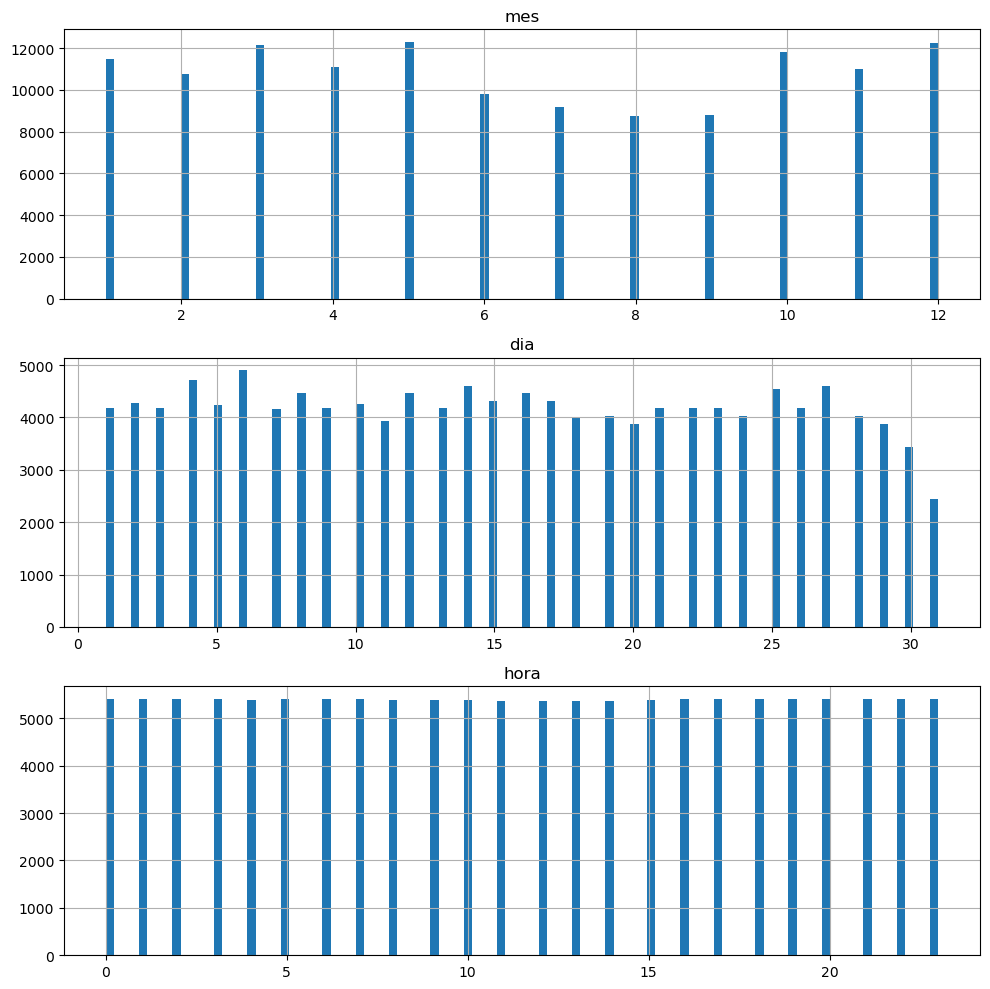

In [101]:
#definição do dataframe e lista de colunas para os gráficos
data = df
lista = list_time


# Controlar a quantidade de colunas para a figura geral
num_colunas = 1  # Defina o número desejado de colunas
num_linhas = -(-len(lista) // num_colunas)  # Calcula o número de linhas necessário


# Gerar histograma
data[lista].hist(
    bins=100,  # Número de divisões do histograma
    figsize=(10,10),
    layout=(num_linhas, num_colunas),
    sharex=False,  # Ajuste para compartilhar ou não o eixo x
    sharey=False   # Ajuste para compartilhar ou não o eixo y
)

# Exibir o gráfico
plt.tight_layout()  # Ajusta o espaçamento
plt.show()

## Analisar variáveis numéricas

### Target

In [102]:
# Coluna target
target = ['target_feature']

In [103]:
df[target].describe()

,target_feature
count,129413.000000
mean,6.326829
std,2.856556
min,0.134232
25%,4.288056
50%,6.042259
75%,7.970540
max,23.964783


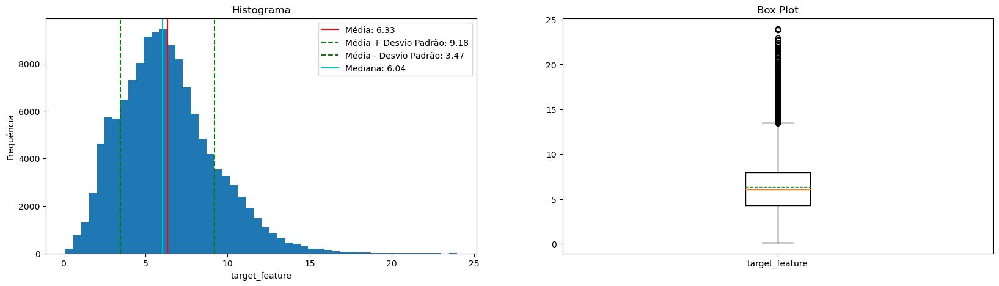

In [104]:
df_graphic = df[target].describe()

for i in target:

    media = df_graphic.loc['mean',i]
    desvio_padrao = df_graphic.loc['std',i]
    mediana = df_graphic.loc['50%',i]

    # Criar figura e subplots
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))  # 1 linha, 2 colunas

    # Gerar histograma
    axs[0].hist(df[i],bins=50)
    axs[0].axvline(x=media, color='r', linestyle='-', label=f'Média: {media:.2f}')
    axs[0].axvline(x=media + desvio_padrao, color='g', linestyle='--', label=f'Média + Desvio Padrão: {media + desvio_padrao:.2f}')
    axs[0].axvline(x=media - desvio_padrao, color='g', linestyle='--', label=f'Média - Desvio Padrão: {media - desvio_padrao:.2f}')
    axs[0].axvline(x=mediana, color='c', linestyle='-', label=f'Mediana: {mediana:.2f}')

    axs[0].set_xlabel(i)
    axs[0].set_ylabel('Frequência')
    axs[0].set_title("Histograma")
    axs[0].legend()


    # Gere um boxplot das variáveis do dataset
    axs[1].boxplot(
        df[i].dropna().values , # dataset apenas com as variáveis
        labels = [i],
        whis = 1.5, # lim_inf = Q1 - whis*IQR, lim_sup = Q3 + whis*IQR ou percentis [5,95]
        meanline = True,
        showmeans = True
    )
    #axs[1].set_xlabel(i)
    axs[1].set_title("Box Plot")


    plt.show()

### Features

In [105]:
df_columns_num

['Wind speed (m/s)',
 'Wind speed (m/s).1',
 'Wind speed (m/s).2',
 'Wind speed (m/s).3',
 'Wind speed (m/s).4',
 'Wind speed, Standard deviation (m/s)',
 'Wind speed, Standard deviation (m/s).1',
 'Wind speed, Standard deviation (m/s).2',
 'Wind speed, Standard deviation (m/s).3',
 'Wind speed, Standard deviation (m/s).4',
 'Wind direction (°)',
 'Wind direction (°).1',
 'Wind direction (°).2',
 'Wind direction (°).3',
 'Wind direction (°).4',
 'Nacelle position (°)',
 'Nacelle position (°).1',
 'Nacelle position (°).2',
 'Nacelle position (°).3',
 'Nacelle position (°).4',
 'Nacelle position, Standard deviation (°)',
 'Nacelle position, Standard deviation (°).1',
 'Nacelle position, Standard deviation (°).2',
 'Nacelle position, Standard deviation (°).3',
 'Nacelle position, Standard deviation (°).4',
 'Vane position 1+2 (°)',
 'Vane position 1+2 (°).1',
 'Vane position 1+2 (°).2',
 'Vane position 1+2 (°).3',
 'Vane position 1+2 (°).4',
 'Power (kW)',
 'Power (kW).1',
 'Power (kW).2'

In [106]:
# Analisar estatística básica
df[df_columns_num].describe()

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
count,129382.000000,100616.000000,129376.000000,129193.000000,129302.000000,129128.000000,100362.000000,129122.000000,128940.000000,129048.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,129128.000000,100549.000000,129122.000000,129123.000000,129048.000000,128954.000000,100376.000000,128946.000000,128948.000000,128869.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,128954.000000,100376.000000,128947.000000,128948.000000,128871.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,128954.000000,100376.000000,128947.000000,128948.000000,128872.000000
mean,6.608867,6.296371,6.474510,6.155607,5.839344,0.899939,0.927601,0.913751,0.946913,0.920016,200.891883,204.339306,200.218570,198.842408,200.943745,201.462011,204.598422,201.385552,199.126978,201.231640,1.531132,1.507561,1.487237,1.675091,1.530398,-0.162059,-0.265637,-0.250251,-0.243005,-0.258501,738.067369,648.686780,678.562457,626.409834,538.522675,10.952922,10.252642,11.123973,10.325013,11.377855,1307.204388,1260.142740,1267.734067,1234.919525,1178.827867,5.627064,6.922372,5.884974,6.166152,9.081670
std,2.900590,2.802894,2.862391,2.829052,2.658436,0.465440,0.473020,0.468463,0.477273,0.461155,91.334672,92.066338,92.113164,91.460799,92.420753,91.570383,92.334797,92.157578,91.629140,92.466120,4.103899,4.185227,4.167695,4.226577,4.257921,13.468707,13.602763,13.711800,14.174983,14.720646,670.141151,647.051602,650.613433,636.718984,596.767972,6.055887,6.082436,6.144751,5.973862,5.973209,483.311888,493.820649,483.827241,484.232705,516.243925,15.713939,17.635964,16.418859,17.020474,21.529018
min,0.061219,0.153413,0.130069,0.129863,0.141900,0.000000,0.000000,0.000000,0.000000,0.000000,0.008851,0.004821,0.008691,0.005421,0.010919,0.013193,0.117982,0.012661,0.075836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-176.037859,-174.035986,-175.803400,-173.619288,-172.900357,-17.083929,-16.573292,-18.454697,-17.280342,-16.873207,-6.677500,-6.982500,-6.925000,-6.800000,-5.985000,-145.258738,-589.246216,-581.759663,-578.886414,-583.419685,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.566530,4.282855,4.455878,4.117782,3.939976,0.562682,0.577470,0.578617,0.604527,0.583917,146.512433,154.757057,141.838632,144.131506,145.048229,148.412292,154.874634,142.623009,144.610382,146.190857,0.000000,0.000000,0.000000,0.000000,0.000000,-5.062359,-5.343828,-5.207340,-5.201648,-5.660774,169.010899,121.708477,142.168906,117.585521,77.207870,6.567500,5.887500,6.675000,5.965000,7.025000,1027.016144,

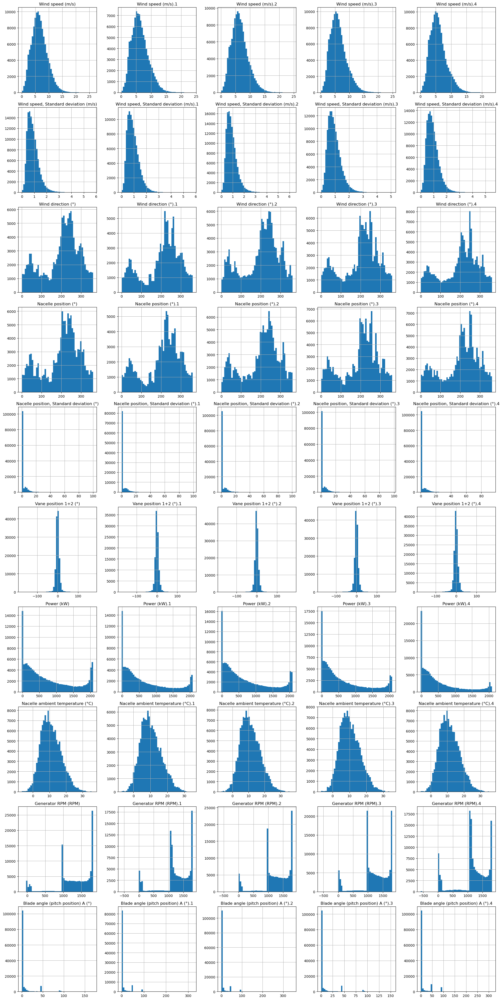

In [107]:
# Controlar a quantidade de colunas para a figura geral
num_colunas = 5  # Defina o número desejado de colunas
num_linhas = -(-len(df_columns_num) // num_colunas)  # Calcula o número de linhas necessário


# Gerar histograma
df[df_columns_num].hist(
    bins=50,
    figsize=(20,40),
    layout=(num_linhas, num_colunas),
    sharex=False,  # Ajuste para compartilhar ou não o eixo x
    sharey=False   # Ajuste para compartilhar ou não o eixo y
)

# Exibir o gráfico
plt.tight_layout()  # Ajusta o espaçamento
plt.show()

#### Wind speed

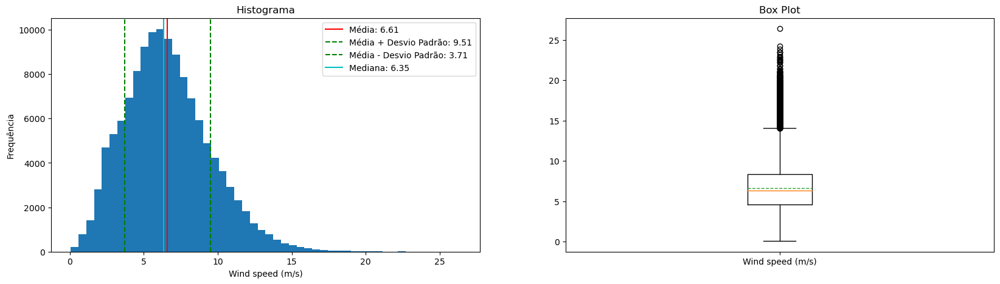

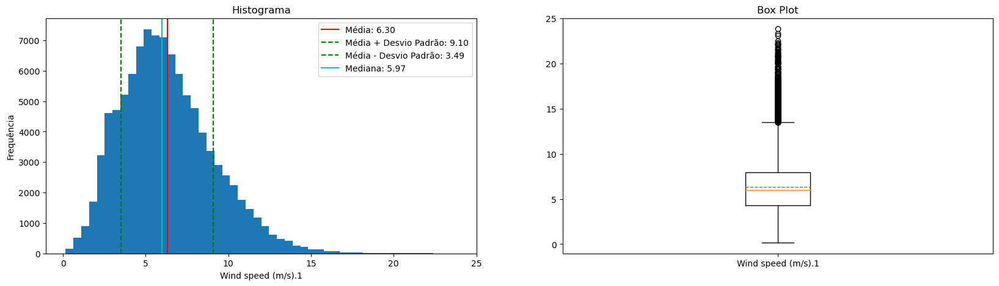

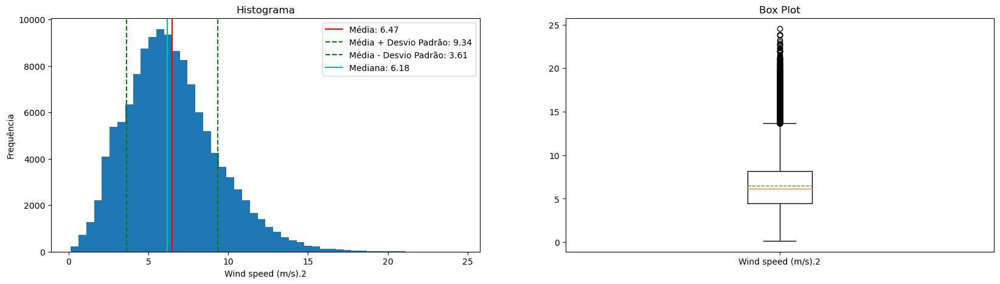

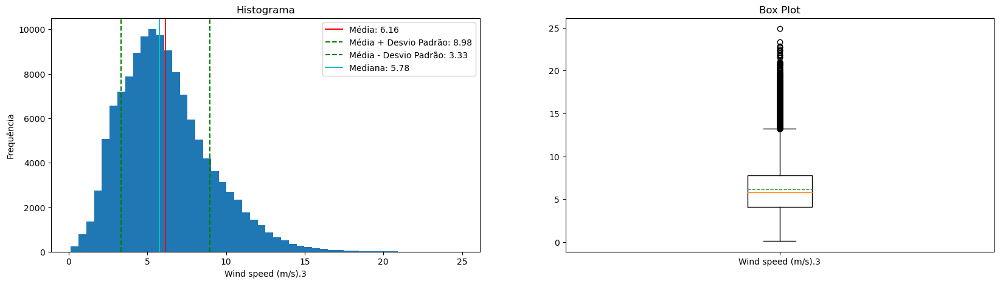

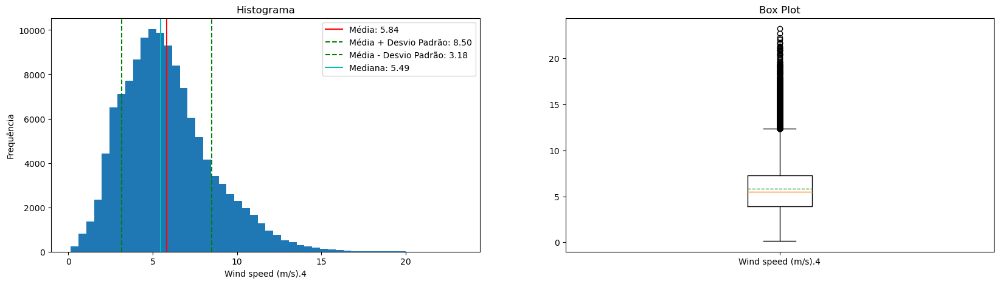

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4
count,129382.000000,100616.000000,129376.000000,129193.000000,129302.000000
mean,6.608867,6.296371,6.474510,6.155607,5.839344
std,2.900590,2.802894,2.862391,2.829052,2.658436
min,0.061219,0.153413,0.130069,0.129863,0.141900
25%,4.566530,4.282855,4.455878,4.117782,3.939976
50%,6.346071,5.971344,6.175519,5.782040,5.489077
75%,8.363530,7.972339,8.137524,7.753229,7.303572
max,26.389881,23.826238,24.538780,24.884069,23.241919


In [110]:
lista = df_columns_num[:5]
data = df[lista]
df_graphic = data.describe()

for i in lista:

    media = df_graphic.loc['mean',i]
    desvio_padrao = df_graphic.loc['std',i]
    mediana = df_graphic.loc['50%',i]

    # Criar figura e subplots
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))  # 1 linha, 2 colunas

    # Gerar histograma
    axs[0].hist(data[i],bins=50)
    axs[0].axvline(x=media, color='r', linestyle='-', label=f'Média: {media:.2f}')
    axs[0].axvline(x=media + desvio_padrao, color='g', linestyle='--', label=f'Média + Desvio Padrão: {media + desvio_padrao:.2f}')
    axs[0].axvline(x=media - desvio_padrao, color='g', linestyle='--', label=f'Média - Desvio Padrão: {media - desvio_padrao:.2f}')
    axs[0].axvline(x=mediana, color='c', linestyle='-', label=f'Mediana: {mediana:.2f}')

    axs[0].set_xlabel(i)
    axs[0].set_ylabel('Frequência')
    axs[0].set_title("Histograma")
    axs[0].legend()


    # Gere um boxplot das variáveis do dataset
    axs[1].boxplot(
        data[i].dropna().values , # dataset apenas com as variáveis
        labels = [i],
        whis = 1.5, # lim_inf = Q1 - whis*IQR, lim_sup = Q3 + whis*IQR ou percentis [5,95]
        meanline = True,
        showmeans = True
    )
    #axs[1].set_xlabel(i)
    axs[1].set_title("Box Plot")


    plt.show()

df_graphic

##### Outliers

In [120]:
# Função de identificação dos outliers
def outliers(data, feature):
    Q1 = np.percentile(data[feature].dropna(),25)
    Q3 = np.percentile(data[feature].dropna(),75)

    #print('Q1: %.2f' %Q1)
    #print('Q3: %.2f' %Q3)

    C = 1.5
    IIQ = Q3 - Q1
    LI = Q1 - C*IIQ
    LS = Q1 + C*IIQ

    #print('IIQ: %.2f' %IIQ)
    #print('Limites:')
    #print(' Inferior: %.2f' %LI)
    #print(' Superior: %.2f' %LS)

    return LI, LS

In [143]:
feature = df_columns_num[0]
data = df

a, b = outliers(data, feature)
print(a,b)

-1.1289687395095855 10.262029266357423


In [144]:
df_outliers_i = data[data[feature]<a]
df_outliers_i

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,target_feature,mes,dia,hora
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [145]:
df_outliers_s = data[data[feature]>b].reset_index() #.sort_values(by=feature, ascending=False)
df_outliers_s

,id,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,target_feature,mes,dia,hora
0,82,2017-10-01 13:40:00,10.843300,9.156364,10.061183,9.917649,9.991252,1.622258,1.806421,1.917649,1.439376,1.529321,205.429794,206.928177,200.041534,197.678268,201.555969,206.584351,203.162979,198.541946,195.095139,196.681519,0.000000,4.390264,5.532646,3.802077,0.000000,-2.730106,2.930248,0.172771,5.380295,8.100503,1822.337646,1424.966675,1715.256470,1717.751831,1755.084229,16.280001,16.175001,16.527500,15.710000,17.065001,1785.108398,1739.466919,1751.148560,1759.356323,1792.122681,3.436884,1.224778,2.849803,2.104779,1.914100,9.936874,10,1,13
1,83,2017-10-01 13:50:00,10.525508,11.576609,11.019443,11.354186,10.167181,1.517589,1.620440,1.174382,1.257115,1.820247,201.766312,203.373215,197.672913,197.964523,203.929611,206.584351,208.008499,202.172455,201.683746,196.681519,0.000000,6.035616,5.911972,0.000000,0.000000,-6.456331,-7.019181,-2.781490,-4.662798,5.546594,1834.059937,1946.982910,1889.744873,2004.204834,1752.425049,16.260000,16.102501,16.460001,15.677500,17.070000,1796.789062,1797.169067,1788.698486,1799.715332,1794.191528,2.145436,3.006348,2.518448,3.064999,2.199985,10.682402,10,1,13
2,85,2017-10-01 14:10:00,10.371977,11.251555,11.348676,10.838191,9.731167,1.540561,1.410648,1.406299,1.949584,1.313970,197.062912,195.518616,197.342606,195.112030,193.888229,205.545853,198.779175,204.805603,201.683746,196.681519,3.132872,0.000000,0.000000,0.000000,0.000000,-3.636899,-2.936772,-7.307640,-4.859978,1.648649,1798.876587,1998.479492,1867.297485,1904.599976,1578.597168,16.430000,16.205000,16.670000,15.807500,17.200001,1798.393066,1793.227539,1792.351929,1788.341431,1791.046143,2.169480,3.832330,3.418553,3.564211,0.380388,10.385509,10,1,14
3,86,2017-10-01 14:20:00,10.564352,10.848600,9.448972,11.540296,10.086535,1.455213,1.233823,1.567670,2.200686,1.454623,196.367920,198.757797,195.258591,194.655472,197.081284,196.047348,198.779175,202.182617,201.683746,196.681519,1.362042,0.000000,5.268322,0.000000,0.000000,3.947776,-1.029842,-5.757675,-7.417234,-0.460112,1811.383179,1871.686890,1480.818115,1847.523193,1611.152344,16.465000,16.250000,16.700001,15.810000,17.195002,1798.989380,1792.559448,1752.407104,1791.237061,1785.749023,2.645035,2.995425,1.278693,3.889723,0.873232,10.408842,10,1,14
4,94,2017-10-01 15:40:00,10.753622,9.041615,10.706135,10.857664,10.808253,0.952270,1.700380,1.105255,1.312643,1.406811,206.528000,208.067169,205.338425,206.035049,205.832092,210.974609,213.047516,207.000732,201.683746,204.417297,0.000000,0.000000,0.000000,0.000000,2.743364,-5.161841,-4.080677,0.506482,4.030227,1.870350,1941.780396,1247.234497,1793.906250,17

In [146]:
df.columns[0]

'Timestamp'

In [147]:
df.columns[1]

'Wind speed (m/s)'

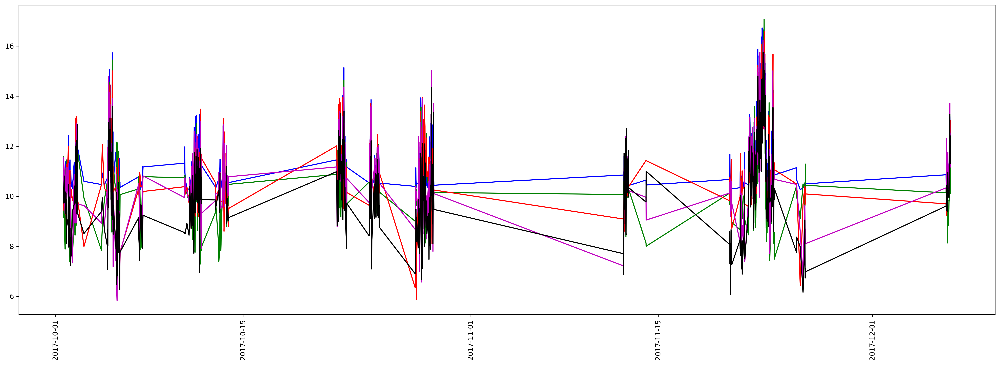

In [ ]:

li=0
ls=1000
f=1
g=2
h=3
i=4
j=5


data = df_outliers_s
plt.figure(dpi=300,figsize=(25,8))
plt.plot(data.iloc[:ls,0], data.iloc[:ls,f], c='blue')
plt.plot(data.iloc[:ls,0], data.iloc[:ls,g], c='g')
plt.plot(data.iloc[:ls,0], data.iloc[:ls,h], c='r')
plt.plot(data.iloc[:ls,0], data.iloc[:ls,i], c='m')
plt.plot(data.iloc[:ls,0], data.iloc[:ls,j], c='black')

#plt.xlabel(df.columns[0])
#plt.ylabel(df.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.xticks(rotation=90)
plt.show()

In [33]:
list_angle_mais = []
for i in list_angle:
    list_angle_mais.append(f'{i}_sin')
    list_angle_mais.append(f'{i}_cos')

list_angle_mais

['Wind direction (°)_sin',
 'Wind direction (°)_cos',
 'Wind direction (°).1_sin',
 'Wind direction (°).1_cos',
 'Wind direction (°).2_sin',
 'Wind direction (°).2_cos',
 'Wind direction (°).3_sin',
 'Wind direction (°).3_cos',
 'Wind direction (°).4_sin',
 'Wind direction (°).4_cos',
 'Nacelle position (°)_sin',
 'Nacelle position (°)_cos',
 'Nacelle position (°).1_sin',
 'Nacelle position (°).1_cos',
 'Nacelle position (°).2_sin',
 'Nacelle position (°).2_cos',
 'Nacelle position (°).3_sin',
 'Nacelle position (°).3_cos',
 'Nacelle position (°).4_sin',
 'Nacelle position (°).4_cos',
 'Nacelle position, Standard deviation (°)_sin',
 'Nacelle position, Standard deviation (°)_cos',
 'Nacelle position, Standard deviation (°).1_sin',
 'Nacelle position, Standard deviation (°).1_cos',
 'Nacelle position, Standard deviation (°).2_sin',
 'Nacelle position, Standard deviation (°).2_cos',
 'Nacelle position, Standard deviation (°).3_sin',
 'Nacelle position, Standard deviation (°).3_cos',
 'Na

In [34]:
def angulo_ciclico(data, list_angle=list_angle):
    for i in list_angle:
        data[f'{i}_sin'] = np.sin(np.radians(data[i]))
        data[f'{i}_cos'] = np.cos(np.radians(data[i]))
    return data

In [35]:
df = angulo_ciclico(df)
df_test = angulo_ciclico(df_test)

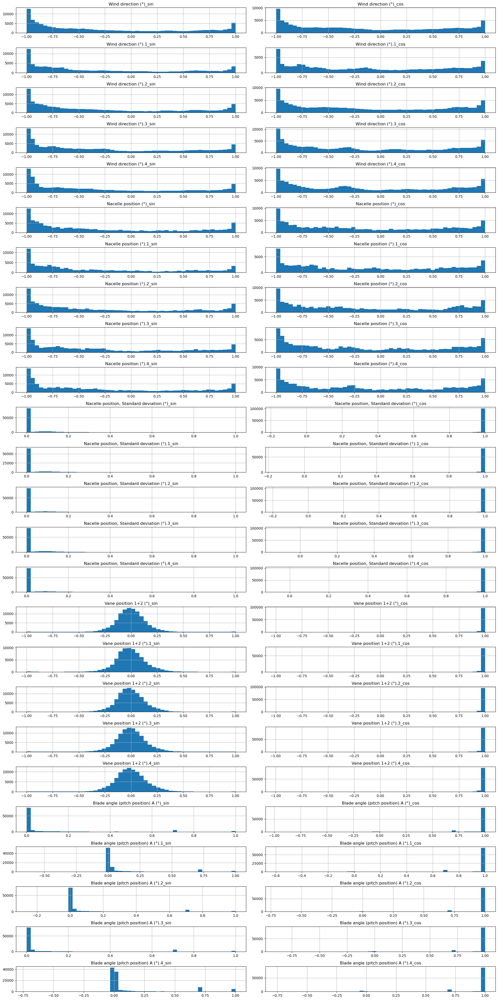

In [49]:
# Controlar a quantidade de colunas para os histogramas
num_colunas = 2  # Defina o número desejado de colunas
num_linhas = -(-len(list_angle_mais) // num_colunas)  # Calcula o número de linhas necessário


# Gerar histograma
df[list_angle_mais].hist(
    bins=50,
    figsize=(20,40),
    layout=(num_linhas, num_colunas),
    sharex=False,  # Ajuste para compartilhar ou não o eixo x
    sharey=False   # Ajuste para compartilhar ou não o eixo y
)

# Exibir o gráfico
plt.tight_layout()  # Ajusta o espaçamento
plt.show()

## Analisar correlação

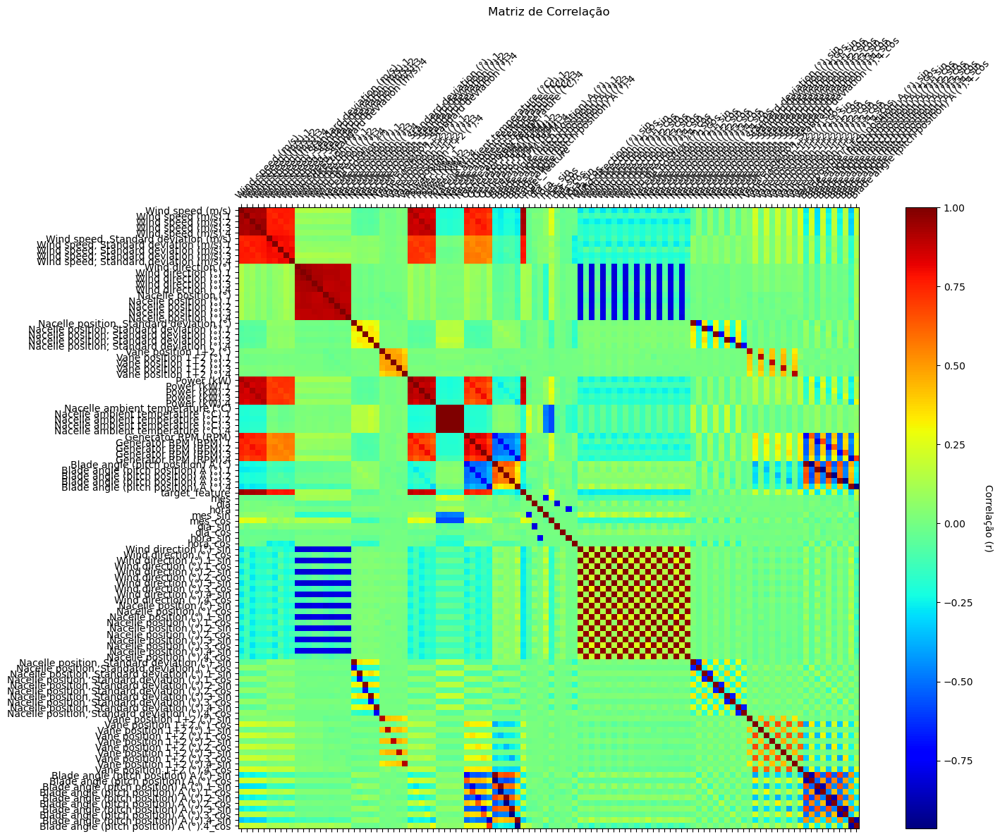

In [50]:
# Calculando a matriz de correlação
corr_matrix = df[df_columns_num + target + list_time + list_time_mais + list_angle_mais].corr()

# Definindo as colunas
columns = list(corr_matrix.columns)

# Criando um mapa de cores
cm = plt.get_cmap('jet')  # Você pode escolher outro cmap, como 'viridis', 'inferno', 'plasma'

# Criando a figura e o eixo
fig, ax = plt.subplots(figsize=(16, 12))

# Exibindo a matriz de correlação
cax = ax.matshow(corr_matrix, cmap=cm)

# Adicionando a barra de cores
cbar = fig.colorbar(cax)
cbar.ax.set_ylabel('Correlação (r)', rotation=270, labelpad=20)

# Configurando os ticks
ax.set_xticks(range(len(columns)))
ax.set_yticks(range(len(columns)))
ax.set_xticklabels(columns, rotation=45, ha="left", rotation_mode="anchor")
ax.set_yticklabels(columns)

# Adicionando título e rótulos, se necessário
plt.title('Matriz de Correlação', pad=20)
plt.tight_layout()  # Para ajustar os elementos na figura

# Exibindo o gráfico
plt.show()

<Figure size 2000x1500 with 0 Axes>

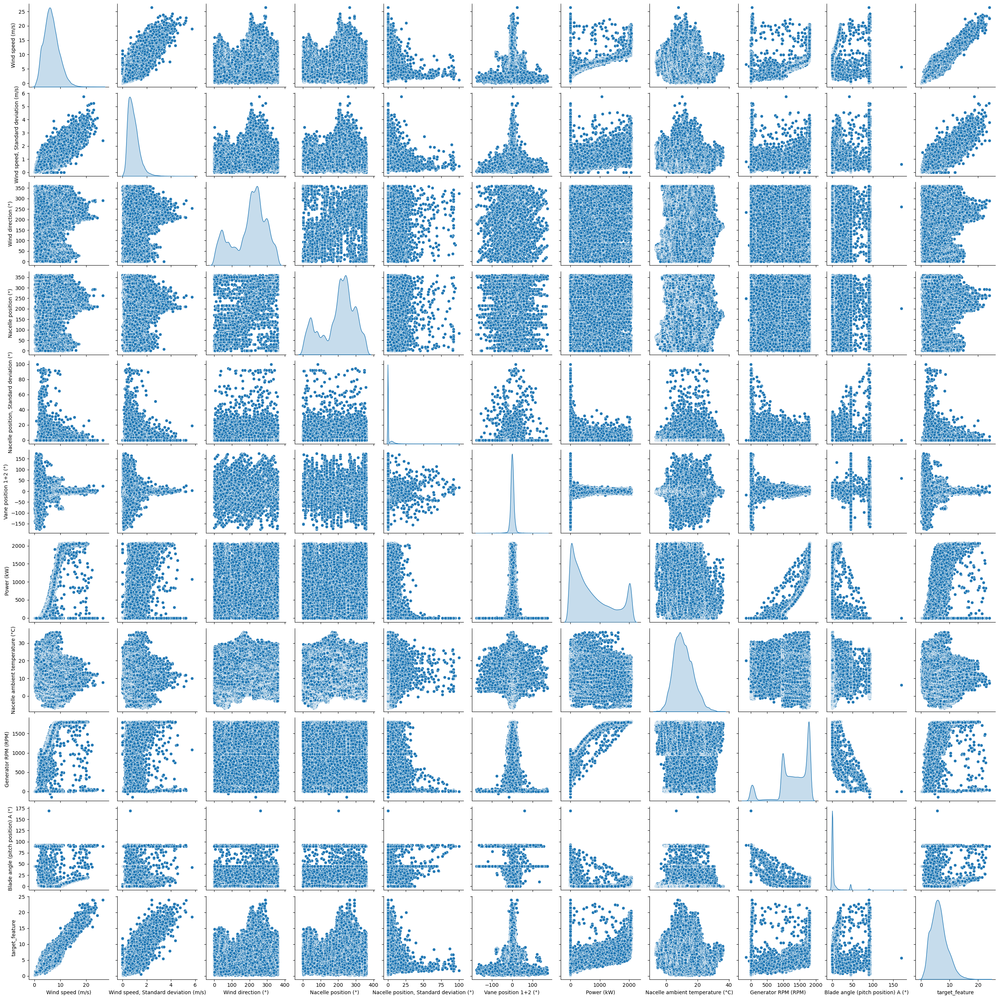

In [51]:
# Gerar o pairplot
plt.figure(figsize=(20,15))
sns.pairplot(df[df_columns_num[0::5] + target], diag_kind='kde')  # `diag_kind='kde'` para usar densidade no lugar de histogramas
plt.show()

<Figure size 2000x1500 with 0 Axes>

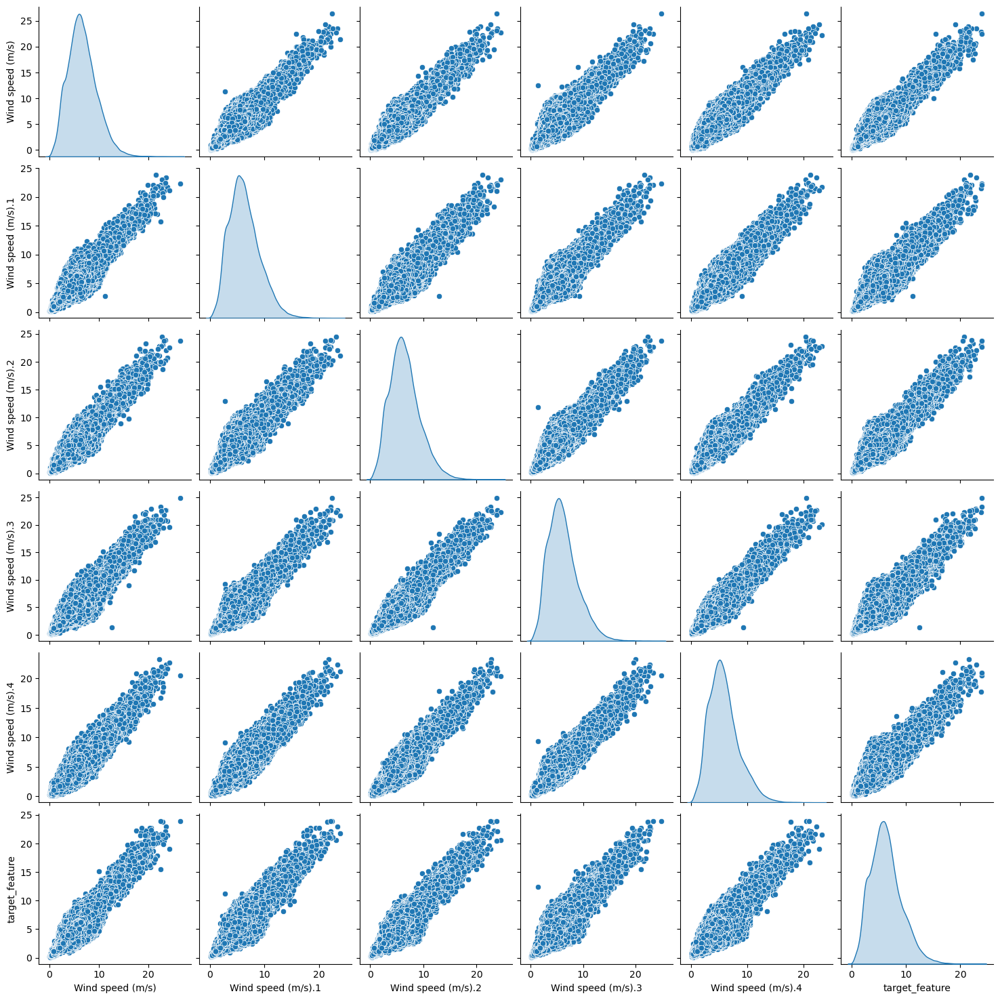

In [155]:
# Gerar o pairplot
plt.figure(figsize=(20,15))
sns.pairplot(df[df_columns_num[:5] + target], diag_kind='kde')  # `diag_kind='kde'` para usar densidade no lugar de histogramas
plt.show()

<Figure size 2000x1500 with 0 Axes>

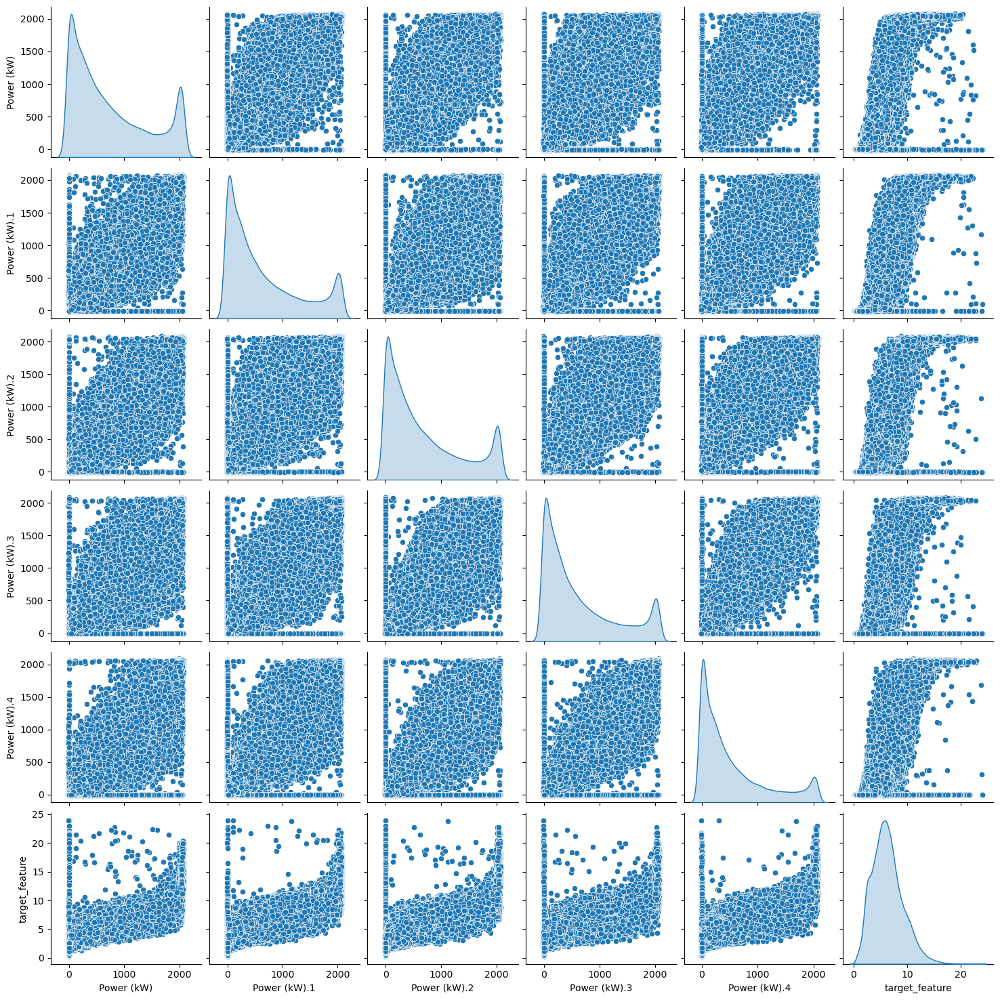

In [156]:
# Gerar o pairplot
plt.figure(figsize=(20,15))
sns.pairplot(df[df_columns_num[30:35] + target], diag_kind='kde')  # `diag_kind='kde'` para usar densidade no lugar de histogramas
plt.show()

## Analisar outliers

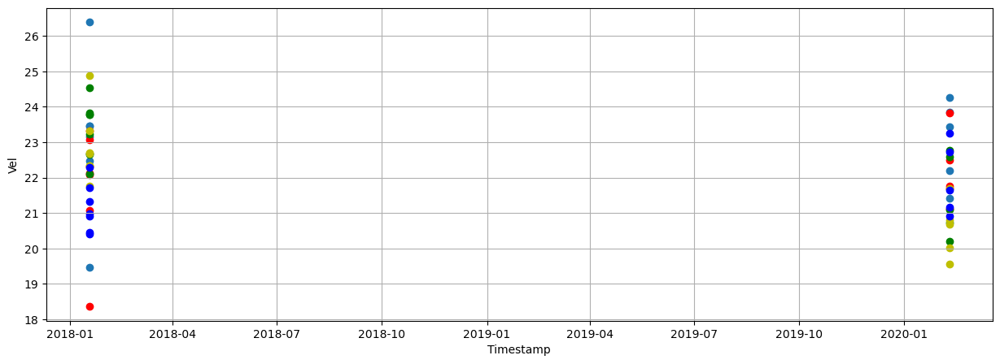

In [157]:
df_analise01 =  df_01[(df_01['Wind speed (m/s)']>23) |
                      (df_01['Wind speed (m/s).1']>23) |
                      (df_01['Wind speed (m/s).2']>23) |
                      (df_01['Wind speed (m/s).3']>23) |
                      (df_01['Wind speed (m/s).4']>23)]

data = df_analise01[['Timestamp','Wind speed (m/s)']]
data2 = df_analise01[['Timestamp','Wind speed (m/s).1']]
data3 = df_analise01[['Timestamp','Wind speed (m/s).2']]
data4 = df_analise01[['Timestamp','Wind speed (m/s).3']]
data5 = df_analise01[['Timestamp','Wind speed (m/s).4']]


plt.figure(figsize=(15,5))
plt.scatter(data.iloc[:,0],data.iloc[:,1])
plt.scatter(data2.iloc[:,0],data2.iloc[:,1], c='r')
plt.scatter(data3.iloc[:,0],data3.iloc[:,1], c='g')
plt.scatter(data4.iloc[:,0],data4.iloc[:,1], c='y')
plt.scatter(data5.iloc[:,0],data5.iloc[:,1], c='b')
plt.xlabel(data.columns[0])
plt.ylabel('Vel')
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

In [158]:
df_analise02 =  df_01[(df_01['Generator RPM (RPM).1']<=0)]
df_analise01 =  df_01[(df_01['Generator RPM (RPM).1']<-10)]

# # Controlar a quantidade de colunas para os histogramas
# num_colunas = 5  # Defina o número desejado de colunas
# num_linhas = -(-len(df_columns_num) // num_colunas)  # Calcula o número de linhas necessário


# # Gerar histograma
# df_analise01[df_columns_num].hist(
#     bins=50,
#     figsize=(20,40),
#     layout=(num_linhas, num_colunas),
#     sharex=False,  # Ajuste para compartilhar ou não o eixo x
#     sharey=False   # Ajuste para compartilhar ou não o eixo y
# )

# # Exibir o gráfico
# plt.tight_layout()  # Ajusta o espaçamento
# plt.show()

In [159]:
len(df_analise01)

2

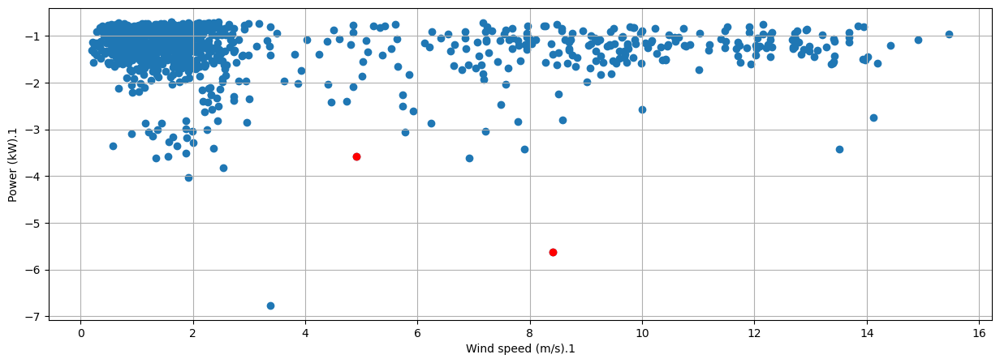

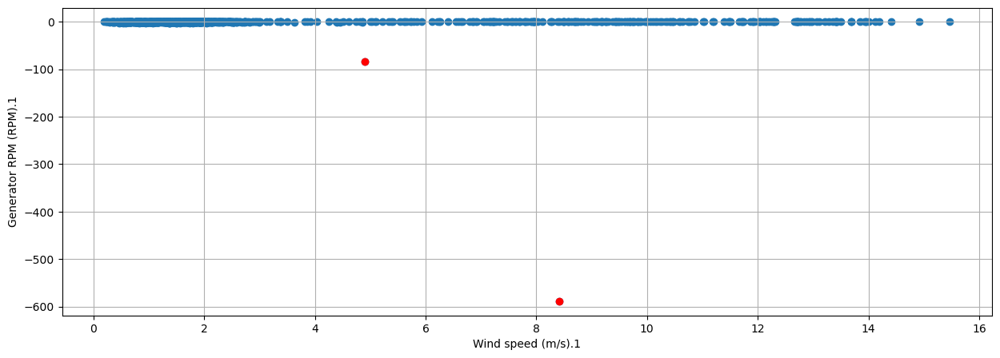

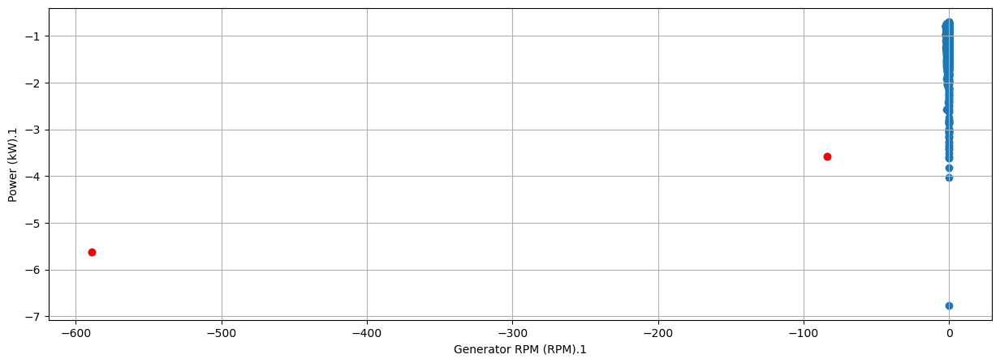

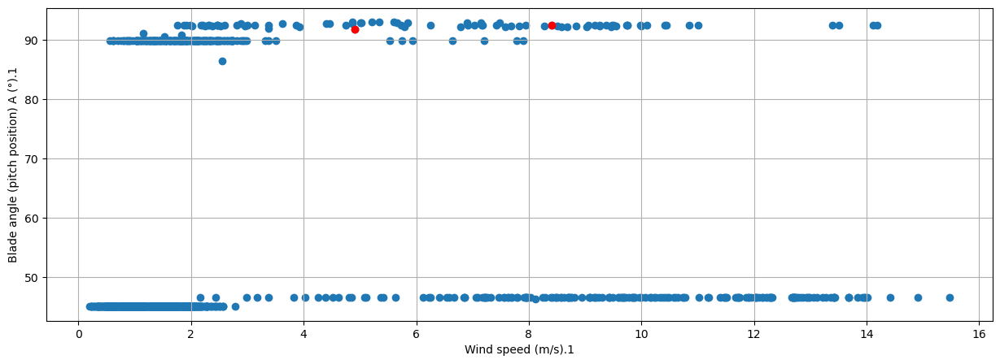

In [160]:

data = df_analise01[['Wind speed (m/s).1','Power (kW).1']]
data2 = df_analise02[['Wind speed (m/s).1','Power (kW).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s).1','Generator RPM (RPM).1']]
data2 = df_analise02[['Wind speed (m/s).1','Generator RPM (RPM).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Generator RPM (RPM).1','Power (kW).1']]
data2 = df_analise02[['Generator RPM (RPM).1','Power (kW).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s).1','Blade angle (pitch position) A (°).1']]
data2 = df_analise02[['Wind speed (m/s).1','Blade angle (pitch position) A (°).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

In [161]:
df_analise02 =  df_01[(df_01['Generator RPM (RPM).2']<=0)]
df_analise01 =  df_01[(df_01['Generator RPM (RPM).2']<-10)]

# # Controlar a quantidade de colunas para os histogramas
# num_colunas = 5  # Defina o número desejado de colunas
# num_linhas = -(-len(df_columns_num) // num_colunas)  # Calcula o número de linhas necessário


# # Gerar histograma
# df_analise01[df_columns_num].hist(
#     bins=50,
#     figsize=(20,40),
#     layout=(num_linhas, num_colunas),
#     sharex=False,  # Ajuste para compartilhar ou não o eixo x
#     sharey=False   # Ajuste para compartilhar ou não o eixo y
# )

# # Exibir o gráfico
# plt.tight_layout()  # Ajusta o espaçamento
# plt.show()

In [162]:
len(df_analise01)

5

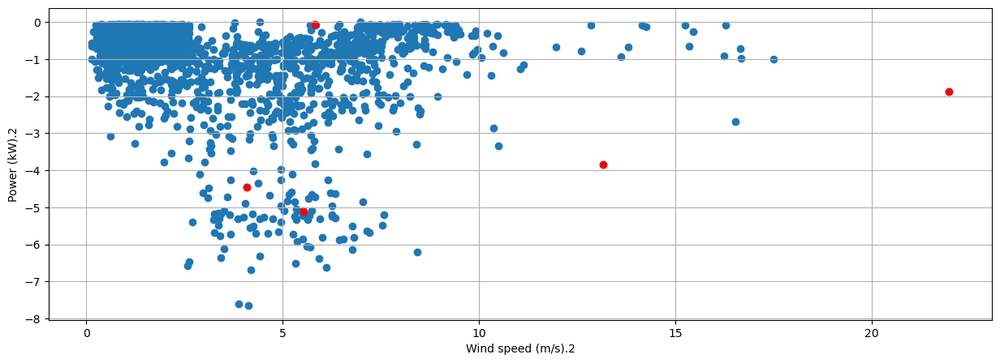

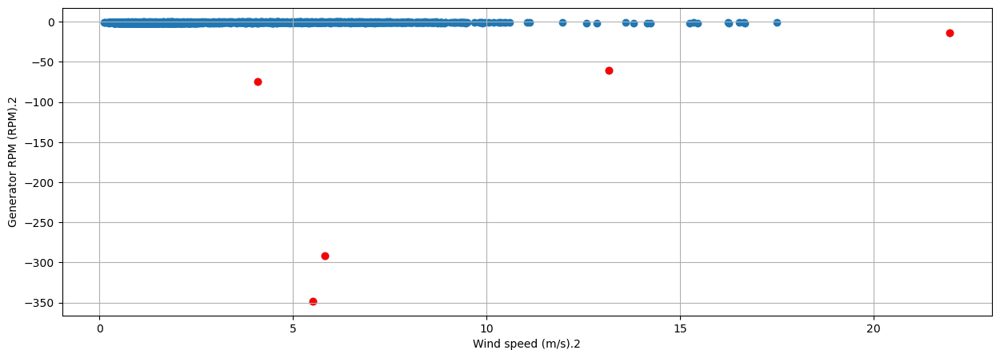

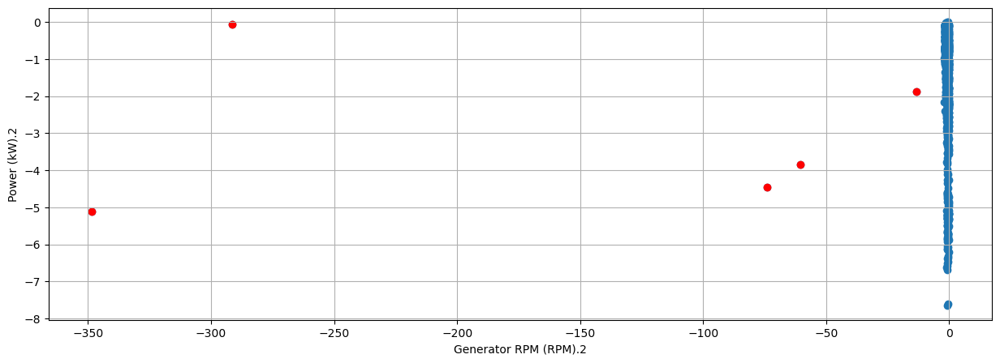

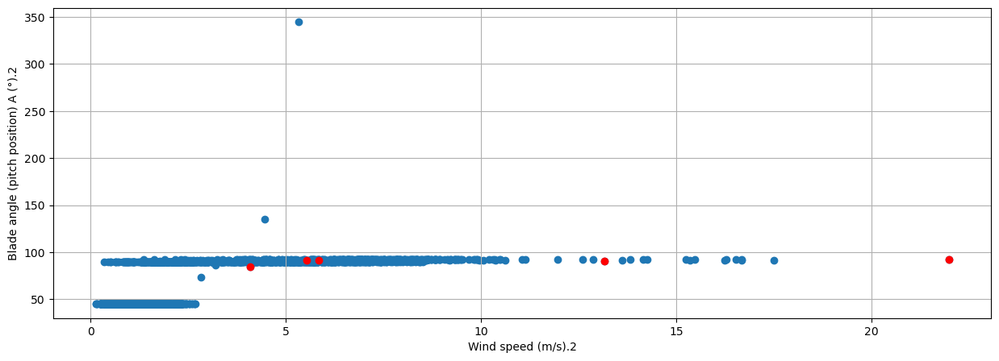

In [163]:

data = df_analise01[['Wind speed (m/s).2','Power (kW).2']]
data2 = df_analise02[['Wind speed (m/s).2','Power (kW).2']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s).2','Generator RPM (RPM).2']]
data2 = df_analise02[['Wind speed (m/s).2','Generator RPM (RPM).2']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Generator RPM (RPM).2','Power (kW).2']]
data2 = df_analise02[['Generator RPM (RPM).2','Power (kW).2']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s).2','Blade angle (pitch position) A (°).2']]
data2 = df_analise02[['Wind speed (m/s).2','Blade angle (pitch position) A (°).2']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()


In [164]:
df_analise02 =  df_01[(df_01['Blade angle (pitch position) A (°)']>=90)]
df_analise01 =  df_01[(df_01['Blade angle (pitch position) A (°)']>100)]

# # Controlar a quantidade de colunas para os histogramas
# num_colunas = 5  # Defina o número desejado de colunas
# num_linhas = -(-len(df_columns_num) // num_colunas)  # Calcula o número de linhas necessário


# # Gerar histograma
# df_analise01[df_columns_num].hist(
#     bins=50,
#     figsize=(20,40),
#     layout=(num_linhas, num_colunas),
#     sharex=False,  # Ajuste para compartilhar ou não o eixo x
#     sharey=False   # Ajuste para compartilhar ou não o eixo y
# )

# # Exibir o gráfico
# plt.tight_layout()  # Ajusta o espaçamento
# plt.show()

In [165]:
len(df_analise01)

1

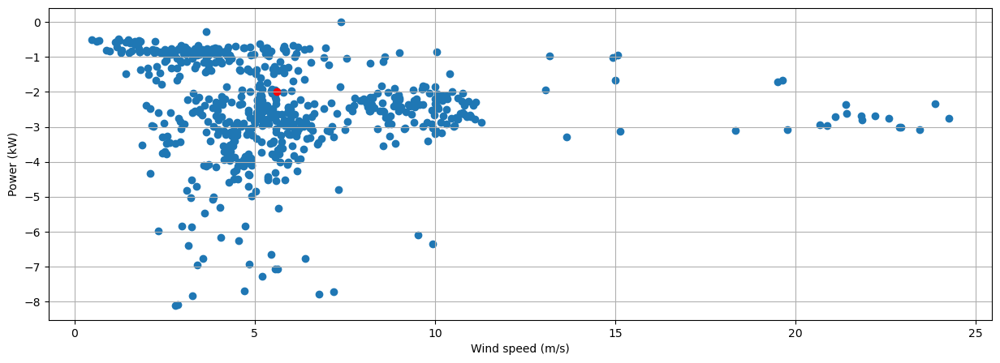

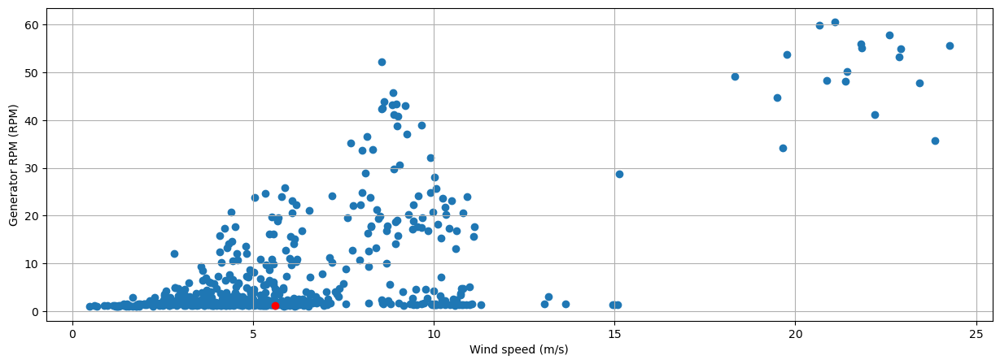

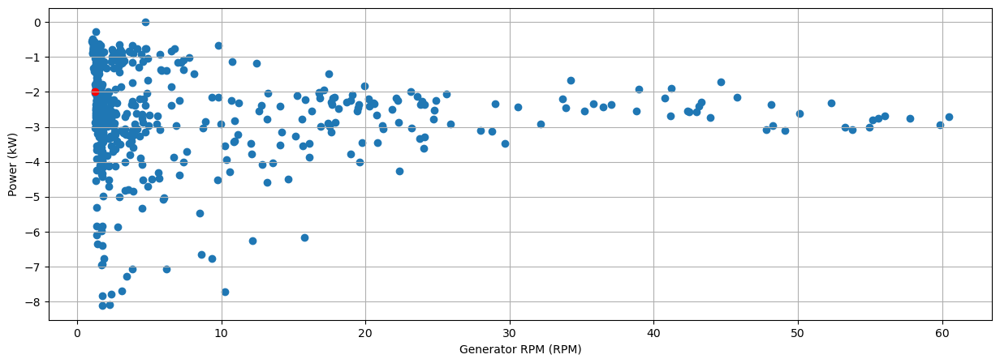

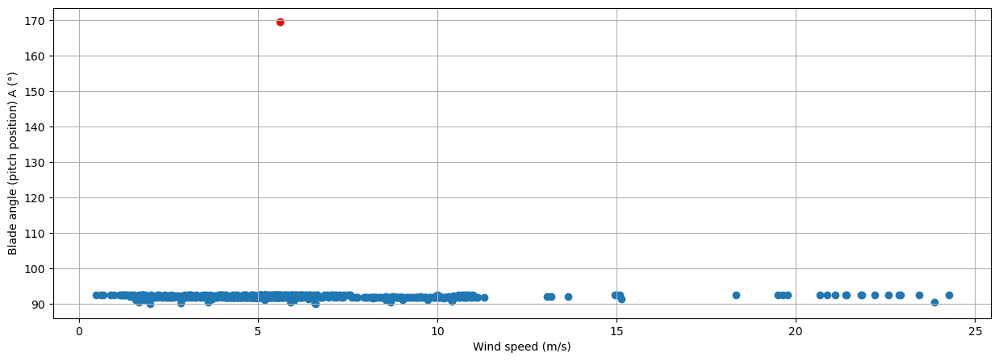

In [166]:

data = df_analise01[['Wind speed (m/s)','Power (kW)']]
data2 = df_analise02[['Wind speed (m/s)','Power (kW)']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s)','Generator RPM (RPM)']]
data2 = df_analise02[['Wind speed (m/s)','Generator RPM (RPM)']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Generator RPM (RPM)','Power (kW)']]
data2 = df_analise02[['Generator RPM (RPM)','Power (kW)']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s)','Blade angle (pitch position) A (°)']]
data2 = df_analise02[['Wind speed (m/s)','Blade angle (pitch position) A (°)']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

In [167]:
df_analise02 =  df_01[(df_01['Blade angle (pitch position) A (°).1']>=90)]
df_analise01 =  df_01[(df_01['Blade angle (pitch position) A (°).1']>100)]

# # Controlar a quantidade de colunas para os histogramas
# num_colunas = 5  # Defina o número desejado de colunas
# num_linhas = -(-len(df_columns_num) // num_colunas)  # Calcula o número de linhas necessário


# # Gerar histograma
# df_analise01[df_columns_num].hist(
#     bins=50,
#     figsize=(20,40),
#     layout=(num_linhas, num_colunas),
#     sharex=False,  # Ajuste para compartilhar ou não o eixo x
#     sharey=False   # Ajuste para compartilhar ou não o eixo y
# )

# # Exibir o gráfico
# plt.tight_layout()  # Ajusta o espaçamento
# plt.show()

In [168]:
len(df_analise01)

2

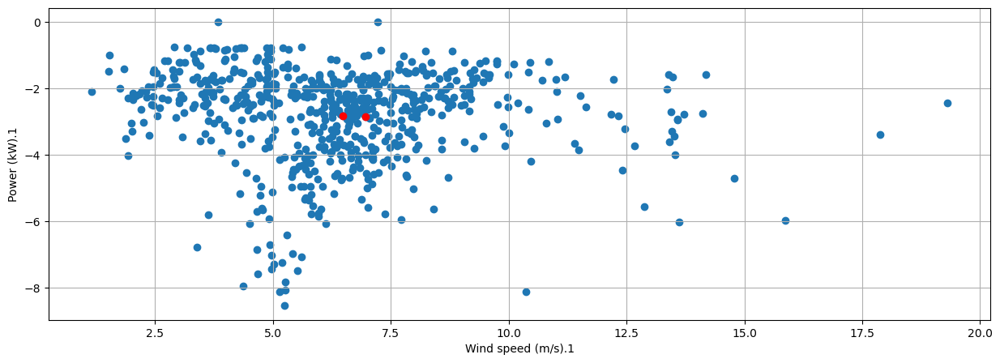

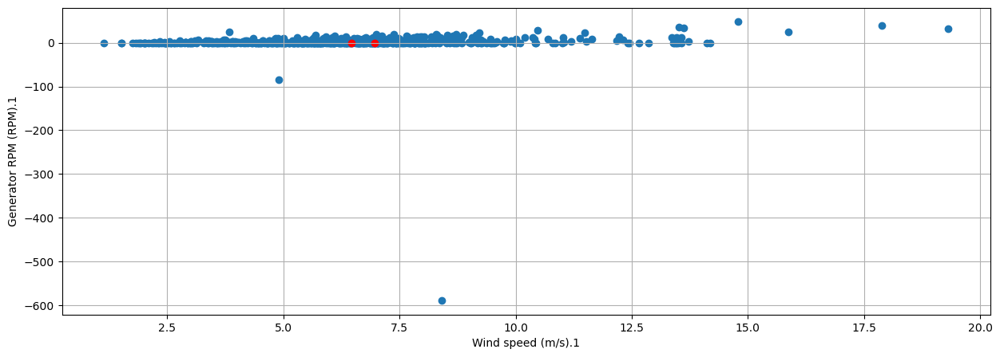

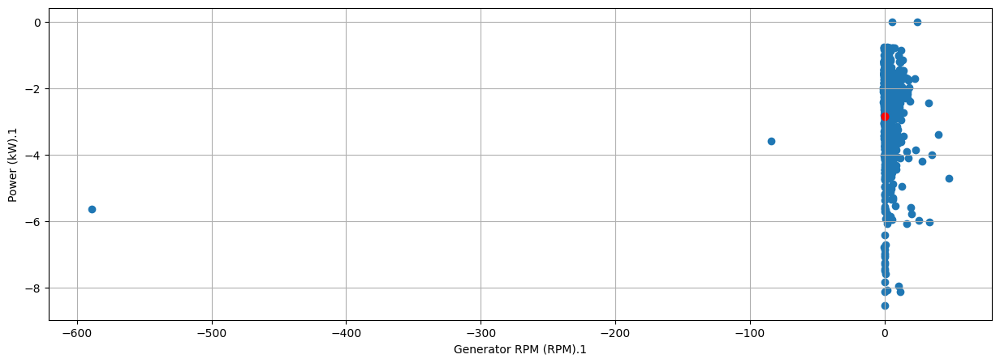

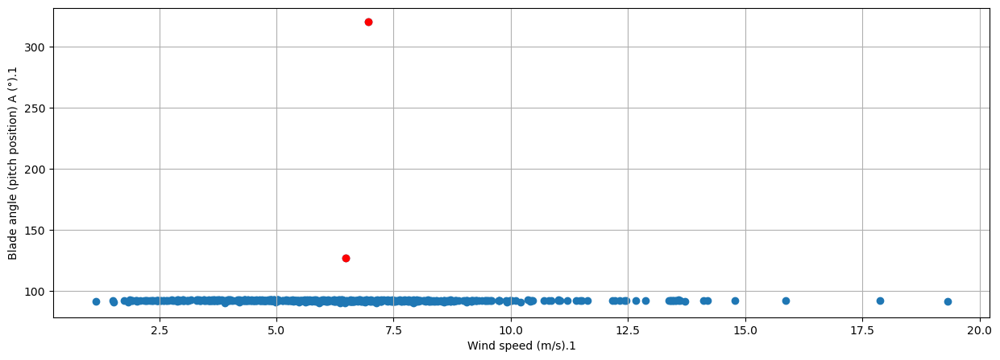

In [169]:
data = df_analise01[['Wind speed (m/s).1','Power (kW).1']]
data2 = df_analise02[['Wind speed (m/s).1','Power (kW).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s).1','Generator RPM (RPM).1']]
data2 = df_analise02[['Wind speed (m/s).1','Generator RPM (RPM).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Generator RPM (RPM).1','Power (kW).1']]
data2 = df_analise02[['Generator RPM (RPM).1','Power (kW).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

data = df_analise01[['Wind speed (m/s).1','Blade angle (pitch position) A (°).1']]
data2 = df_analise02[['Wind speed (m/s).1','Blade angle (pitch position) A (°).1']]

plt.figure(figsize=(15,5))
plt.scatter(data2.iloc[:,0],data2.iloc[:,1])
plt.scatter(data.iloc[:,0],data.iloc[:,1], c='r')
plt.xlabel(data.columns[0])
plt.ylabel(data.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.grid(True)
plt.show()

## Analisar por Redução de Dimensionalidade

In [170]:
features = df_columns_num + list_time + list_time_mais + list_angle_mais

scaler=StandardScaler()
dfscaler = scaler.fit_transform(df[features+target].dropna())
dfscaler = pd.DataFrame(dfscaler, columns=[features+target])

dfscaler

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,mes,dia,hora,mes_sin,mes_cos,dia_sin,dia_cos,hora_sin,hora_cos,Wind direction (°)_sin,Wind direction (°)_cos,Wind direction (°).1_sin,Wind direction (°).1_cos,Wind direction (°).2_sin,Wind direction (°).2_cos,Wind direction (°).3_sin,Wind direction (°).3_cos,Wind direction (°).4_sin,Wind direction (°).4_cos,Nacelle position (°)_sin,Nacelle position (°)_cos,Nacelle position (°).1_sin,Nacelle position (°).1_cos,Nacelle position (°).2_sin,Nacelle position (°).2_cos,Nacelle position (°).3_sin,Nacelle position (°).3_cos,Nacelle position (°).4_sin,Nacelle position (°).4_cos,"Nacelle position, Standard deviation (°)_sin","Nacelle position, Standard deviation (°)_cos","Nacelle position, Standard deviation (°).1_sin","Nacelle position, Standard deviation (°).1_cos","Nacelle position, Standard deviation (°).2_sin","Nacelle position, Standard deviation (°).2_cos","Nacelle position, Standard deviation (°).3_sin","Nacelle position, Standard deviation (°).3_cos","Nacelle position, Standard deviation (°).4_sin","Nacelle position, Standard deviation (°).4_cos",Vane position 1+2 (°)_sin,Vane position 1+2 (°)_cos,Vane position 1+2 (°).1_sin,Vane position 1+2 (°).1_cos,Vane position 1+2 (°).2_sin,Vane position 1+2 (°).2_cos,Vane position 1+2 (°).3_sin,Vane position 1+2 (°).3_cos,Vane position 1+2 (°).4_sin,Vane position 1+2 (°).4_cos,Blade angle (pitch position) A (°)_sin,Blade angle (pitch position) A (°)_cos,Blade angle (pitch position) A (°).1_sin,Blade angle (pitch position) A (°).1_cos,Blade angle (pitch position) A (°).2_sin,Blade angle (pitch position) A (°).2_cos,Blade angle (pitch position) A (°).3_sin,Blade angle (pitch position) A (°).3_cos,Blade angle (pitch position) A (°).4_sin,Blade angle (pitch position) A (°).4_cos,target_feature
0,0.824832,1.033321,0.778044,0.878815,0.656092,0.440206,0.357441,0.173525,0.505270,0.785625,-0.406050,-0.361542,-0.390027,-0.368352,-0.387262,-0.352855,-0.325164,-0.424069,-0.453920,-0.364908,-0.375393,-0.360936,-0.256606,-0.403266,-0.359556,-0.427981,-0.277770,0.102970,0.455621,-0.365174,1.056524,1.135754,0.872325,0.741405,0.484577,0.392082,0.444149,0.425386,0.432581,0.482282,0.978786,1.053702,1.011535,1.005416,0.804113,-0.350618,-0.384125,-0.361575,-0.365673,-0.430000,1.063660,-1.632543,-1.659808,-1.405942,0.584675,0.249534,1.412219,0.002341,1.410711,0.823670,-1.251906,0.713996,-1.303253,0.808344,-1.252745,0.804943,-1.213029,0.804622,-1.250880,0.697918,-1.279760,0.623791,-1.315876,0.875438,-1.245346,1.003504,-1.163954,0.735287,-1.269303,-0.396342,0.126301,-0.381084,0.128075,-0.270881,0.118902,-0.423620,0.139737,-0.380095,0.126775,-0.572616,0.14627

In [ ]:
tsne = TSNE(n_components=2)

X_tsne = tsne.fit_transform(dfscaler.drop(columns=target))

X_tsne

C:\Users\terce\AppData\Local\Temp\ipykernel_3320\153606206.py:3: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X_tsne = tsne.fit_transform(dfscaler.drop(columns=target))
c:\Users\terce\anaconda3\envs\unifor\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\terce\anaconda3\envs\unifor\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


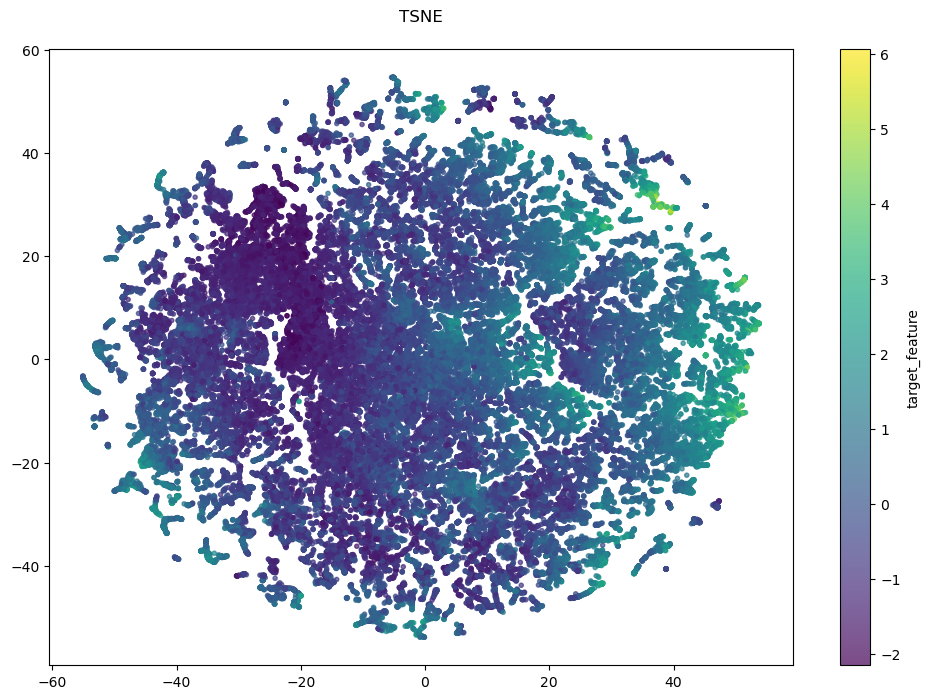

In [ ]:
colors = dfscaler[target].values

plt.figure(figsize=(12, 8))
plt.scatter(X_tsne[:,0], X_tsne[:, 1], marker='.', cmap='viridis', alpha=0.7, c=colors)
plt.colorbar(label=target[0])
plt.title('TSNE', pad=20)
plt.show()

In [ ]:
pca=PCA(n_components=2)

X_pca = pca.fit_transform(dfscaler.drop(columns=target))

X_pca

C:\Users\terce\AppData\Local\Temp\ipykernel_3320\3832721254.py:3: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X_pca = pca.fit_transform(dfscaler.drop(columns=target))


array([[-2.21138602, -4.22262163],
       [-2.20647052, -4.14982175],
       [-2.59357898, -3.87460106],
       ...,
       [ 0.4316398 ,  1.93009934],
       [ 1.79435559,  2.79917067],
       [ 1.67405835,  2.41006077]])

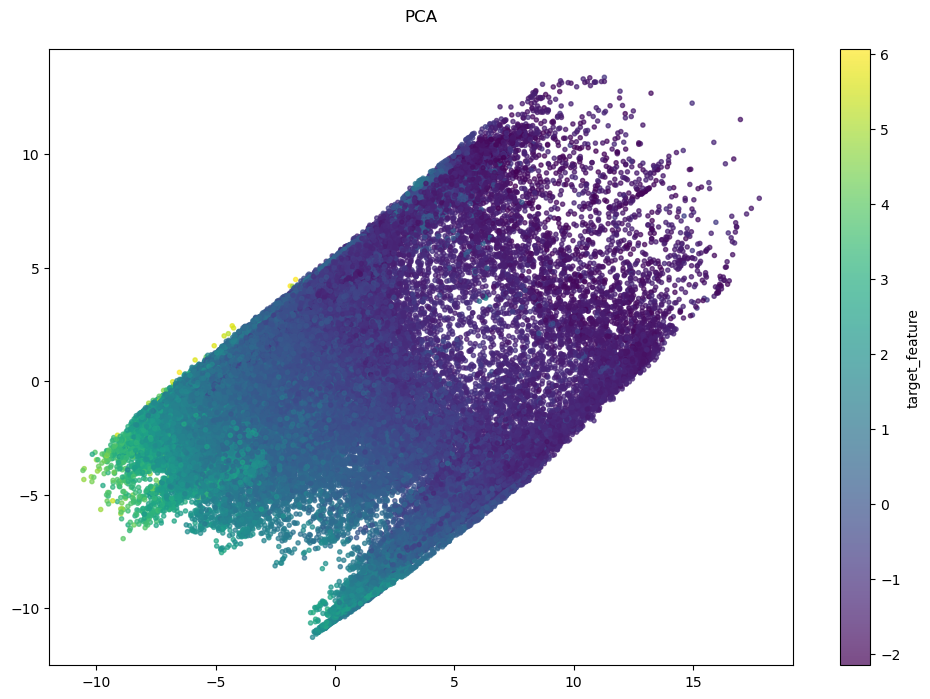

In [ ]:
colors = dfscaler[target].values

plt.figure(figsize=(12, 8))
plt.scatter(X_pca[:,0], X_pca[:, 1], marker='.', cmap='viridis', alpha=0.7, c=colors)
plt.colorbar(label=target[0])
plt.title('PCA', pad=20)
plt.show()

# 5. Pré-processamento dos Dados e Comparação de Resultados

In [36]:
# Criar DF par armazenar performance dos métodos desenvolvidos
df_comparacao = pd.DataFrame(columns=['MAE', 'MSE', 'RMSE', 'R2'])

In [37]:
# Criando um dicionário com os modelos
modelos = {
    "Linear Regression": LinearRegression(),
    "Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
    "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42),
    "LightGBM": LGBMRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
}

# Função para treinar e avaliar os modelos
def avaliar_modelos(modelos, X_train, X_test, y_train, y_test, df_comparacao, nome_df):
    resultados = []
    
    for nome, modelo in modelos.items():
        # Treina o modelo
        modelo.fit(X_train, y_train)
        
        # Faz previsões no conjunto de teste
        y_pred = modelo.predict(X_test)
        
        # Calcula as métricas
        mae = mean_absolute_error(y_test, y_pred)
        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        r2 = r2_score(y_test, y_pred)
        
        # Salva os resultados
        resultados.append({"Modelo": nome, "MSE": mse, "R²": r2})
        df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
    print(df_comparacao)
    # Converte a lista de resultados para um DataFrame
    return df_comparacao


## Versão 1 - Apagando linhas com valores ausentes.

In [39]:
# todas as linhas contendo valores ausentes removidas

df_01 = df.copy()
df_01.dropna(axis=0,how='any',subset=df_columns_num+target,inplace=True)

df_01_test = df_test.copy()
df_01_test.dropna(axis=0,how='any',subset=df_columns_num+target,inplace=True)

In [40]:
print('Quantidade de linhas inicialmente:', len(df))
print('Quantidade de linhas apagadas:', len(df)-len(df_01))
print('Porcentagem de linhas apagadas:', ((len(df)-len(df_01))/len(df))*100)

Quantidade de linhas inicialmente: 103530
Quantidade de linhas apagadas: 23534
Porcentagem de linhas apagadas: 22.7315753887762


In [41]:
nan_verification(df_01)

,Count,Perc
Timestamp,0,0.000000
Wind direction (°).4_cos,0,0.000000
"Nacelle position, Standard deviation (°)_sin",0,0.000000
Nacelle position (°).4_cos,0,0.000000
Nacelle position (°).4_sin,0,0.000000
...,...,...
Power (kW).2,0,0.000000
Power (kW).1,0,0.000000
Power (kW),0,0.000000
Vane position 1+2 (°).4,0,0.000000


### Gráfico

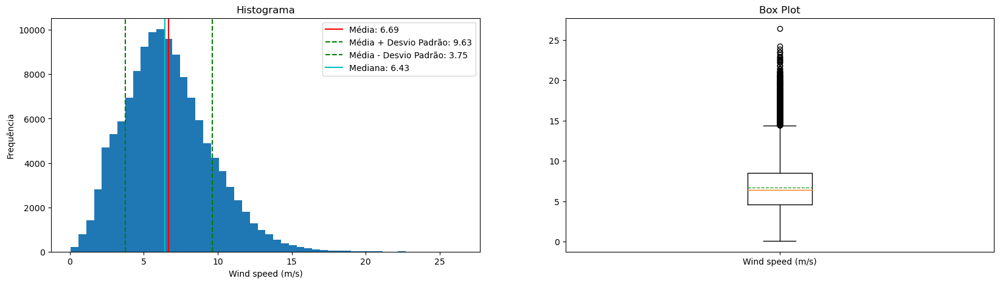

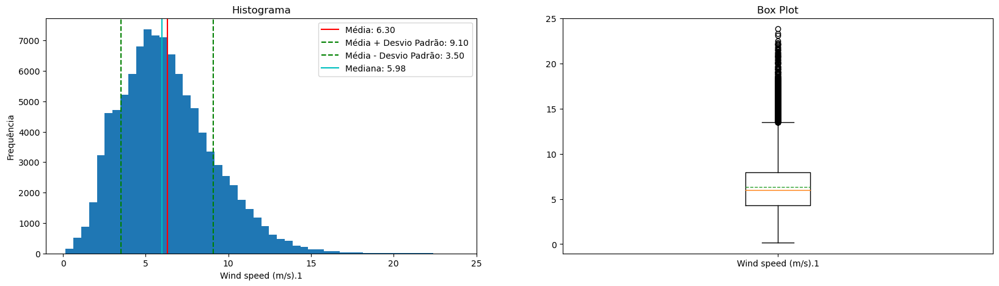

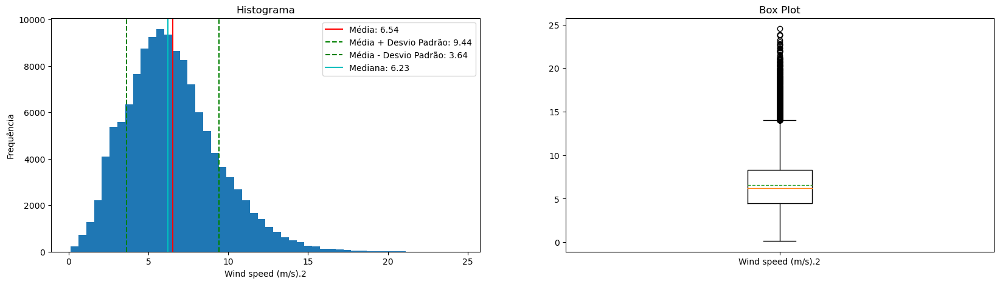

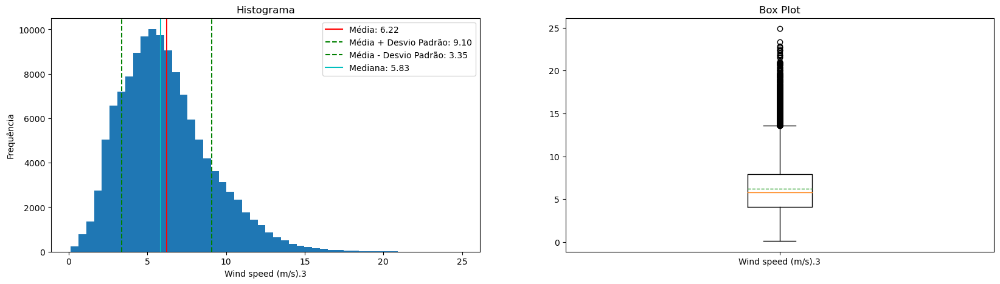

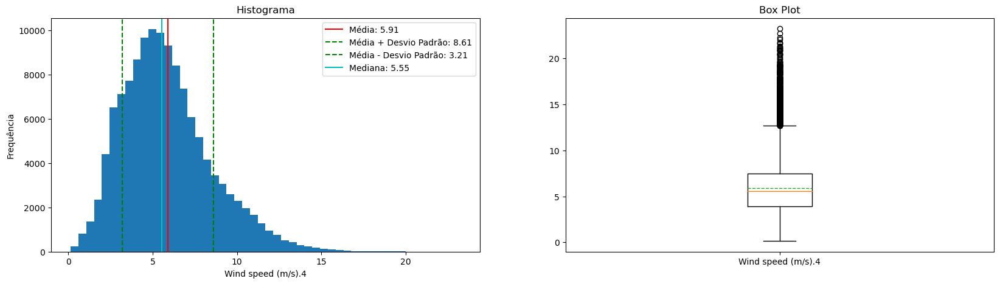

...

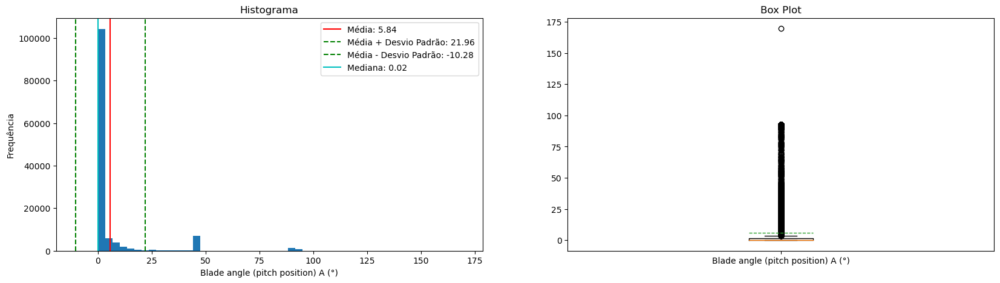

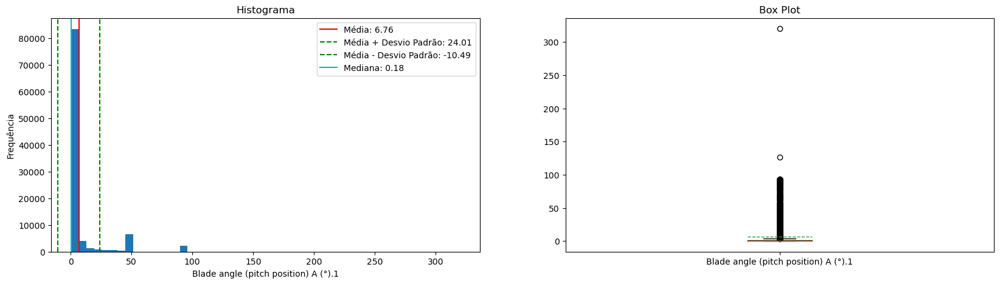

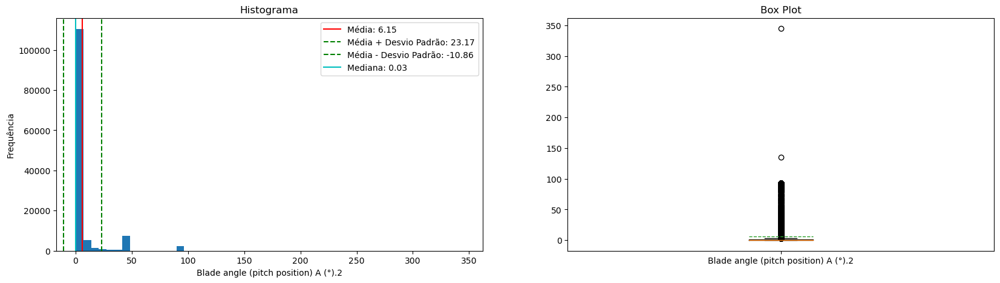

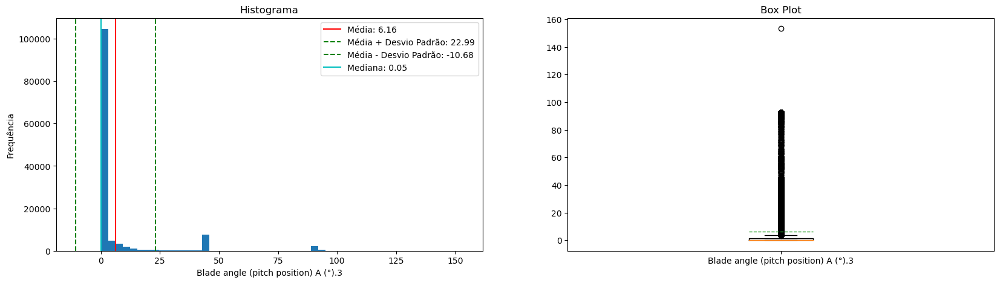

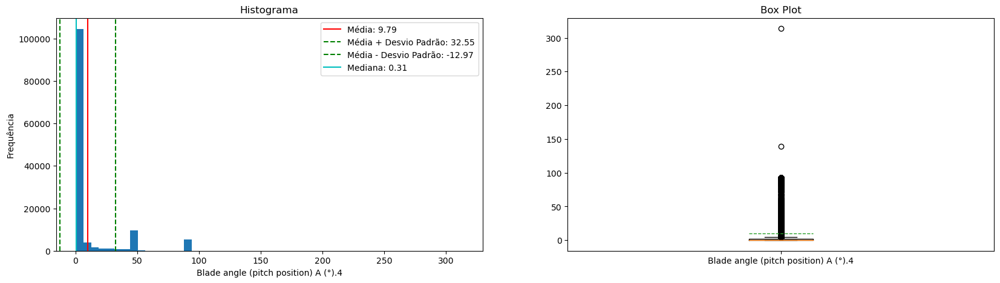

In [80]:
df_graphic = df_01[df_columns_num].describe()

for i in df_columns_num:

    media = df_graphic.loc['mean',i]
    desvio_padrao = df_graphic.loc['std',i]
    mediana = df_graphic.loc['50%',i]

    # Criar figura e subplots
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))  # 1 linha, 2 colunas

    # Gerar histograma
    axs[0].hist(df[i],bins=50)
    axs[0].axvline(x=media, color='r', linestyle='-', label=f'Média: {media:.2f}')
    axs[0].axvline(x=media + desvio_padrao, color='g', linestyle='--', label=f'Média + Desvio Padrão: {media + desvio_padrao:.2f}')
    axs[0].axvline(x=media - desvio_padrao, color='g', linestyle='--', label=f'Média - Desvio Padrão: {media - desvio_padrao:.2f}')
    axs[0].axvline(x=mediana, color='c', linestyle='-', label=f'Mediana: {mediana:.2f}')

    axs[0].set_xlabel(i)
    axs[0].set_ylabel('Frequência')
    axs[0].set_title("Histograma")
    axs[0].legend()


    # Gere um boxplot das variáveis do dataset
    axs[1].boxplot(
        df_01[i].dropna().values , # dataset apenas com as variáveis
        labels = [i],
        whis = 1.5, # lim_inf = Q1 - whis*IQR, lim_sup = Q3 + whis*IQR ou percentis [5,95]
        meanline = True,
        showmeans = True
    )
    #axs[1].set_xlabel(i)
    axs[1].set_title("Box Plot")


    plt.show()

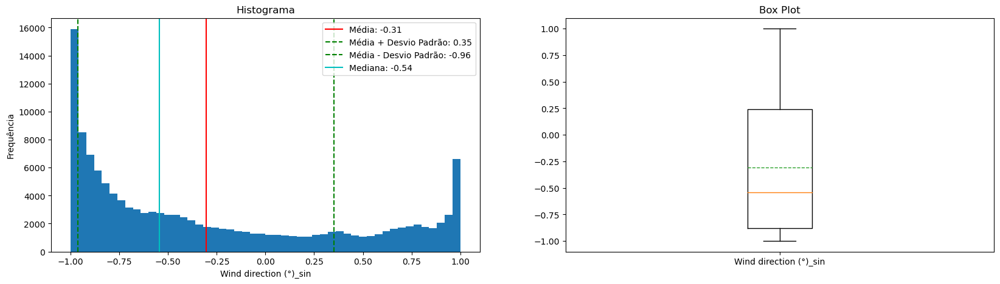

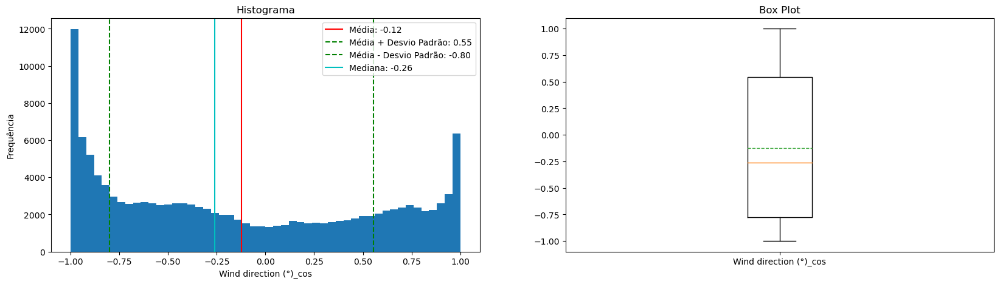

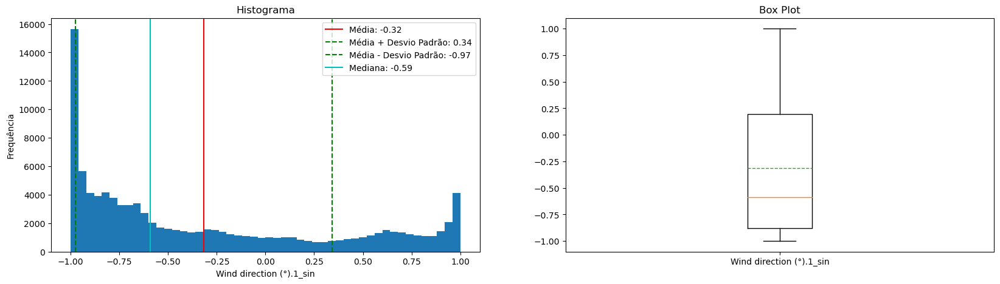

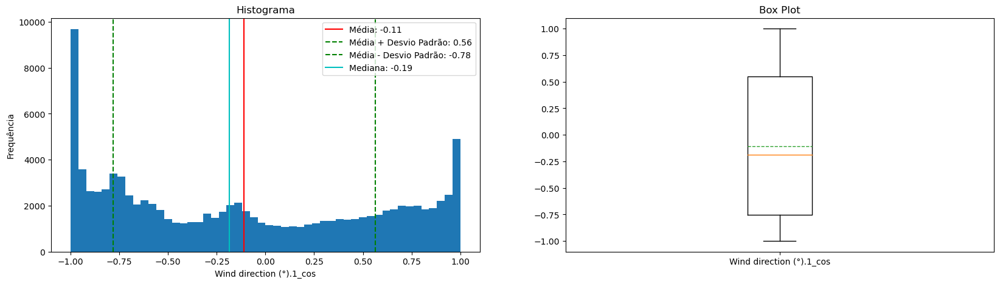

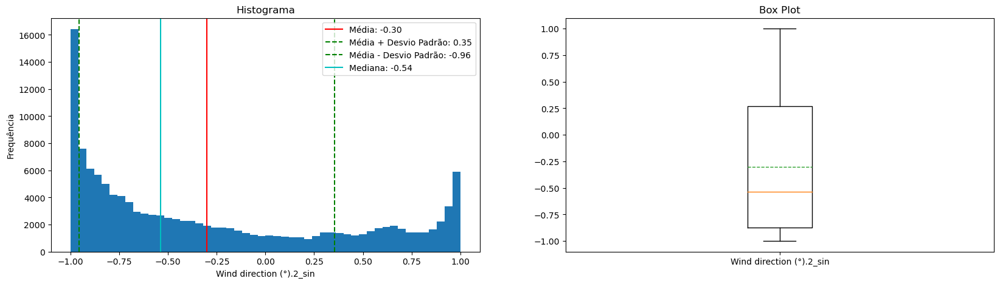

...

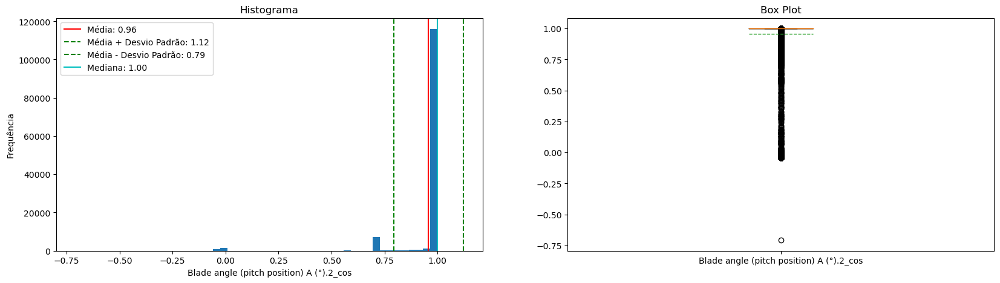

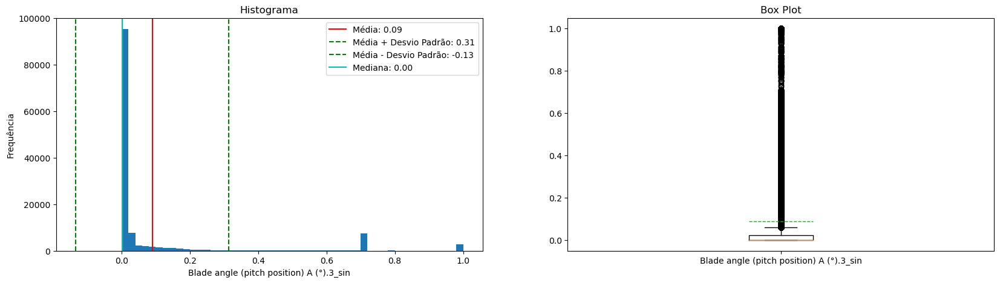

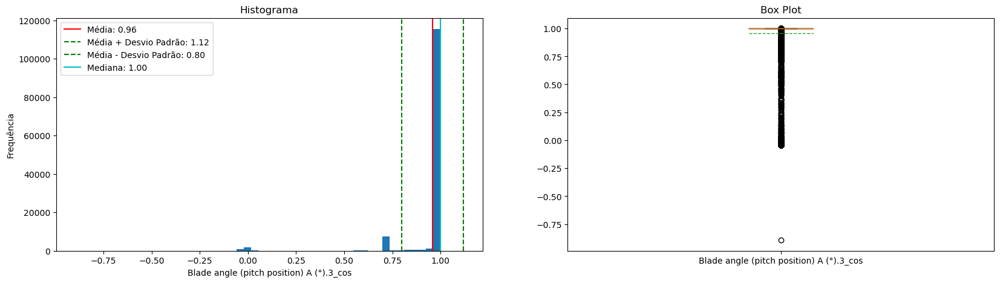

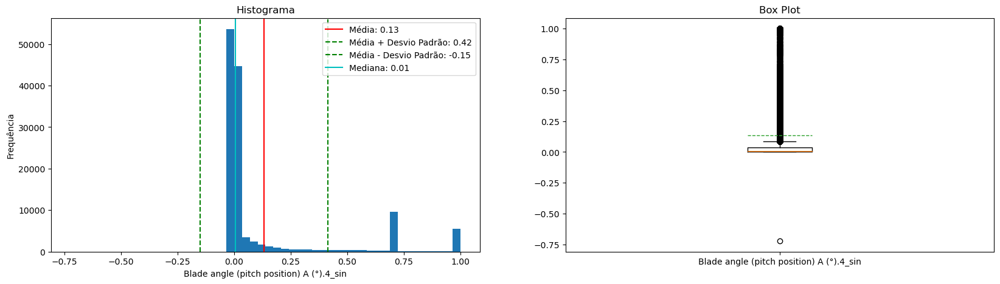

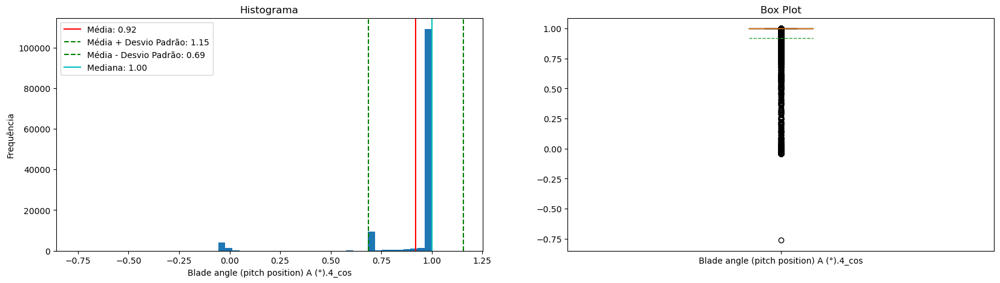

In [81]:
df_graphic = df_01[list_angle_mais].describe()

for i in list_angle_mais:

    media = df_graphic.loc['mean',i]
    desvio_padrao = df_graphic.loc['std',i]
    mediana = df_graphic.loc['50%',i]

    # Criar figura e subplots
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))  # 1 linha, 2 colunas

    # Gerar histograma
    axs[0].hist(df[i],bins=50)
    axs[0].axvline(x=media, color='r', linestyle='-', label=f'Média: {media:.2f}')
    axs[0].axvline(x=media + desvio_padrao, color='g', linestyle='--', label=f'Média + Desvio Padrão: {media + desvio_padrao:.2f}')
    axs[0].axvline(x=media - desvio_padrao, color='g', linestyle='--', label=f'Média - Desvio Padrão: {media - desvio_padrao:.2f}')
    axs[0].axvline(x=mediana, color='c', linestyle='-', label=f'Mediana: {mediana:.2f}')

    axs[0].set_xlabel(i)
    axs[0].set_ylabel('Frequência')
    axs[0].set_title("Histograma")
    axs[0].legend()


    # Gere um boxplot das variáveis do dataset
    axs[1].boxplot(
        df_01[i].dropna().values , # dataset apenas com as variáveis
        labels = [i],
        whis = 1.5, # lim_inf = Q1 - whis*IQR, lim_sup = Q3 + whis*IQR ou percentis [5,95]
        meanline = True,
        showmeans = True
    )
    #axs[1].set_xlabel(i)
    axs[1].set_title("Box Plot")


    plt.show()

### Teste

In [42]:
X_train = df_01[df_columns_num].values
y_train = df_01[target].values
X_test = df_01_test[df_columns_num].values
y_test = df_01_test[target].values
nome_df = 'df_01'   

df_comparacao = avaliar_modelos(modelos, X_train, X_test, y_train, y_test, df_comparacao, nome_df)

C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignor

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Number of data points in the train set: 79996, number of used features: 50
[LightGBM] [Info] Start training from score 6.407135
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


## Versão 2 - Filtragem e Limpeza dos Dados

In [48]:
df_02 = df.copy()

df_02_test = df_test.copy()

In [49]:
df_columns_num[45:50]

['Blade angle (pitch position) A (°)',
 'Blade angle (pitch position) A (°).1',
 'Blade angle (pitch position) A (°).2',
 'Blade angle (pitch position) A (°).3',
 'Blade angle (pitch position) A (°).4']

In [50]:
# Tratando valores incoerentes na colunas
#  df_columns_num[40:45]
#  ['Generator RPM (RPM)',
#  'Generator RPM (RPM).1',
#  'Generator RPM (RPM).2',
#  'Generator RPM (RPM).3',
#  'Generator RPM (RPM).4']

# df_analise02 =  df_02[(df_02['Generator RPM (RPM).2']<=0) & (df_02['Generator RPM (RPM).2']>=-10)]['Generator RPM (RPM).2'].mean()
# df_analise01 =  df_02[(df_02['Generator RPM (RPM).2']<-10)]

for i in df_columns_num[40:45]:
    # Substituir valores abaixo de -10 por 0
    df_02.loc[df_02[i] < -10, i] = df_02[(df_02[i]<=0) & (df_02[i]>=-10)][i].mean()
    df_02_test.loc[df_02_test[i] < -10, i] = df_02_test[(df_02_test[i]<=0) & (df_02_test[i]>=-10)][i].mean()

for i in df_columns_num[45:50]:
    # Substituir valores abaixo de -10 por 0
    df_02.loc[df_02[i] > 100, i] = df_02[(df_02[i]<=100) & (df_02[i]>=90)][i].mean()
    df_02_test.loc[df_02_test[i] > 100, i] = df_02_test[(df_02_test[i]<=100) & (df_02_test[i]>=90)][i].mean()




In [56]:
df_02.dropna(axis=0,how='any',subset=df_columns_num+target,inplace=True)
df_02_test.dropna(axis=0,how='any',subset=df_columns_num+target,inplace=True)

### Gráfico

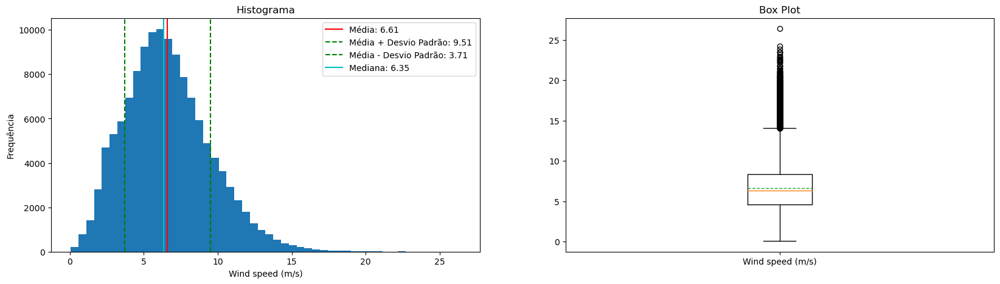

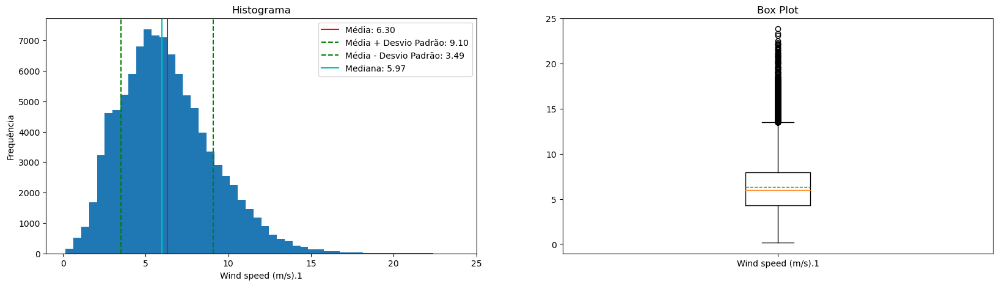

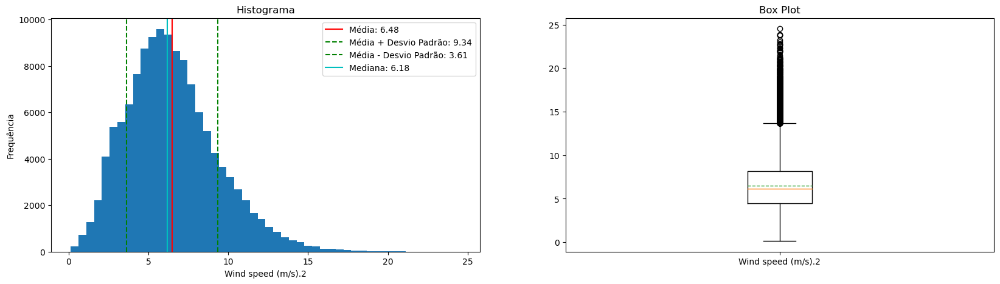

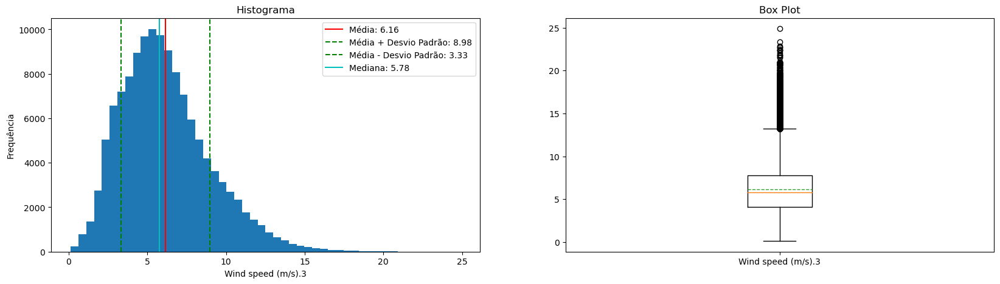

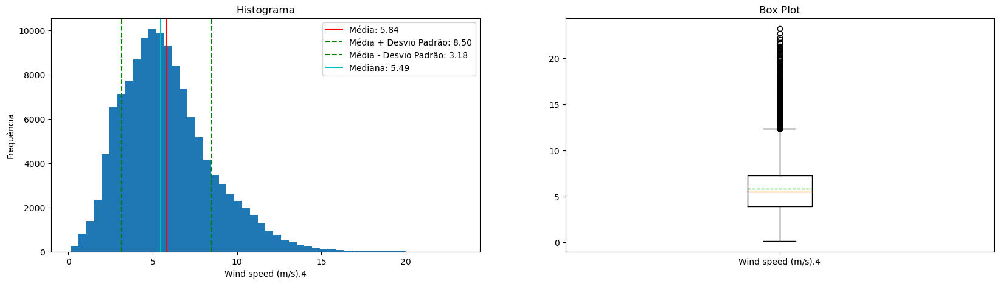

...

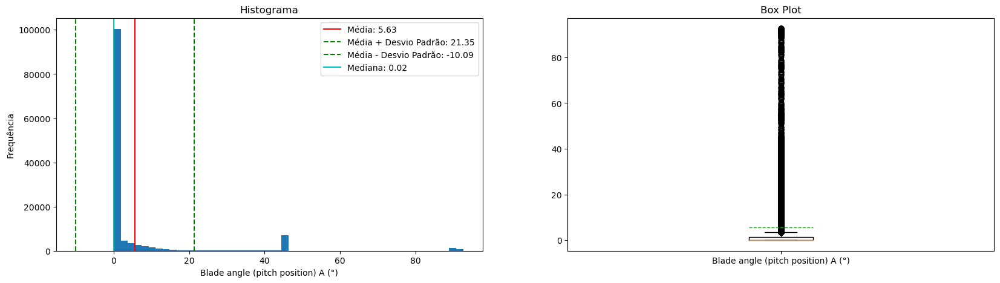

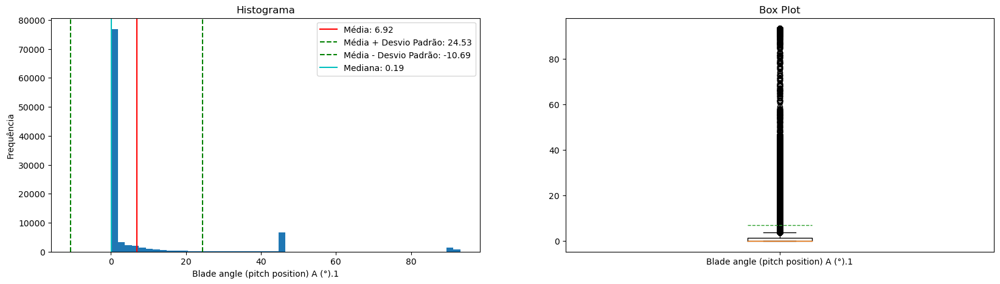

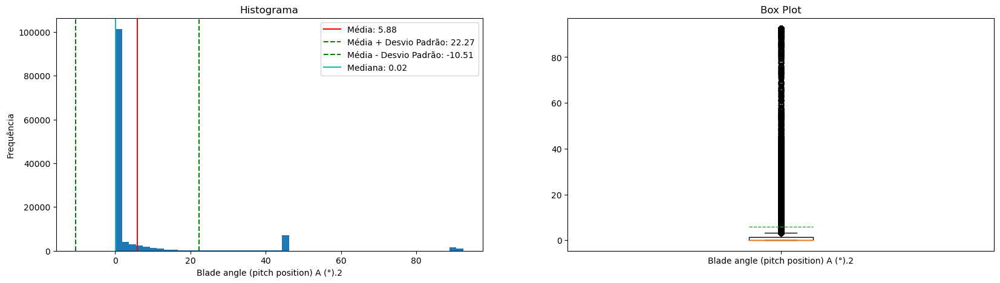

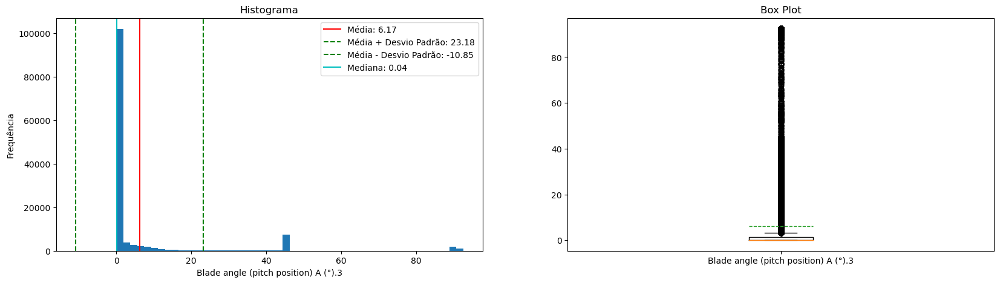

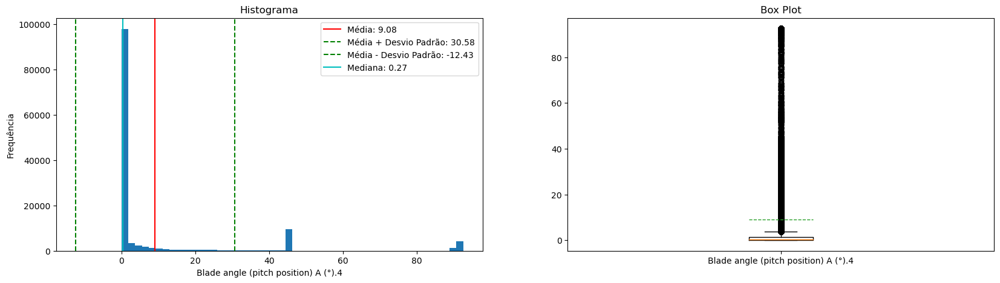

In [ ]:
df_graphic = df_02[df_columns_num].describe()

for i in df_columns_num:

    media = df_graphic.loc['mean',i]
    desvio_padrao = df_graphic.loc['std',i]
    mediana = df_graphic.loc['50%',i]

    # Criar figura e subplots
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))  # 1 linha, 2 colunas

    # Gerar histograma
    axs[0].hist(df_02[i],bins=50)
    axs[0].axvline(x=media, color='r', linestyle='-', label=f'Média: {media:.2f}')
    axs[0].axvline(x=media + desvio_padrao, color='g', linestyle='--', label=f'Média + Desvio Padrão: {media + desvio_padrao:.2f}')
    axs[0].axvline(x=media - desvio_padrao, color='g', linestyle='--', label=f'Média - Desvio Padrão: {media - desvio_padrao:.2f}')
    axs[0].axvline(x=mediana, color='c', linestyle='-', label=f'Mediana: {mediana:.2f}')

    axs[0].set_xlabel(i)
    axs[0].set_ylabel('Frequência')
    axs[0].set_title("Histograma")
    axs[0].legend()


    # Gere um boxplot das variáveis do dataset
    axs[1].boxplot(
        df_02[i].dropna().values , # dataset apenas com as variáveis
        labels = [i],
        whis = 1.5, # lim_inf = Q1 - whis*IQR, lim_sup = Q3 + whis*IQR ou percentis [5,95]
        meanline = True,
        showmeans = True
    )
    #axs[1].set_xlabel(i)
    axs[1].set_title("Box Plot")


    plt.show()

### Teste

In [59]:
X_train = df_02[df_columns_num].values
y_train = df_02[target].values
X_test = df_02_test[df_columns_num].values
y_test = df_02_test[target].values
nome_df = 'df_02'   

df_comparacao = avaliar_modelos(modelos, X_train, X_test, y_train, y_test, df_comparacao, nome_df)

C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignor

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008381 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12749
[LightGBM] [Info] Number of data points in the train set: 79996, number of used features: 50
[LightGBM] [Info] Start training from score 6.407135
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

C:\Users\terce\AppData\Local\Temp\ipykernel_24956\305930528.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'nome_df': nome_df, 'modelo': nome,'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


In [60]:
df_comparacao

,MAE,MSE,RMSE,R2,nome_df,modelo
0,0.542013,0.599419,0.774222,0.927834,df_01,Linear Regression
1,0.324791,0.188282,0.433915,0.977332,df_01,Random Forest
2,0.381464,0.254902,0.504878,0.969311,df_01,XGBoost
3,0.383943,0.257976,0.507914,0.968941,df_01,LightGBM
4,0.542035,0.599431,0.774229,0.927832,df_02,Linear Regression
5,0.324726,0.188133,0.433743,0.977350,df_02,Random Forest
6,0.381464,0.254902,0.504878,0.969311,df_02,XGBoost
7,0.383943,0.257976,0.507914,0.968941,df_02,LightGBM


## Versão 3 - Trantando valores ausentes

In [61]:
# Retirando do df as linhas com valores ausentes em qualquer coluna fora as colunas que possuem mais de 2000 registros ausentes.
df_nan = nan_verification(df[df_columns_num])

list_base_nan = list(df_nan[df_nan['Count'] > 2000].index)
list_base_compl = list(df_nan[df_nan['Count'] <= 2000].index)

In [63]:


df_03  = df[~df[list_base_compl+target].isna().any(axis=1)].copy()
nan_verification(df_03)


,Count,Perc
Wind speed (m/s).1,22873,22.235076
"Wind speed, Standard deviation (m/s).1",22873,22.235076
Nacelle position (°).1_sin,22871,22.233131
Nacelle position (°).1,22871,22.233131
"Nacelle position, Standard deviation (°).1_cos",22871,22.233131
...,...,...
Nacelle ambient temperature (°C).3,0,0.000000
Nacelle ambient temperature (°C).2,0,0.000000
Nacelle ambient temperature (°C),0,0.000000
Power (kW).4,0,0.000000


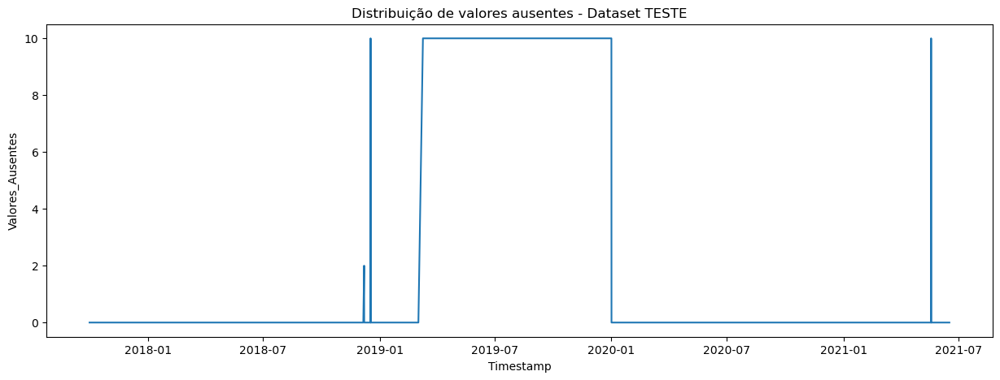

In [ ]:
# Criando df com timestamp e quantidade de valores ausentes por linha
dist_ausentes_teste = pd.DataFrame({
    'Timestamp': df_03['Timestamp'],
    'Valores_Ausentes': df_03.isna().sum(axis=1)
}, index=df_03.index)

plt.figure(figsize=(15,5))
plt.plot(dist_ausentes_teste.iloc[:,0], dist_ausentes_teste.iloc[:,1])
plt.xlabel(dist_ausentes_teste.columns[0])
plt.ylabel(dist_ausentes_teste.columns[1])
plt.title('Distribuição de valores ausentes - Dataset TESTE')
#plt.legend()
plt.show()

In [ ]:
print('Quantidade de linhas inicialmente:', len(df))
print('Quantidade de linhas apagadas:', len(df)-len(df_03))
print('Porcentagem de linhas apagadas:', ((len(df)-len(df_03))/len(df_03))*100)

Quantidade de linhas inicialmente: 130608
Quantidade de linhas apagadas: 2010
Porcentagem de linhas apagadas: 1.5630103112023515


In [ ]:
# Avaliação do melhor método para preenchimento de valores faltantes
data = df_03 # Mudar para  Dataset de referência

for i in list_base_nan:
    # Preenchimento por modelo linear
    mask_null = data[i].isna()
    X_fill = data[list_base_compl][~mask_null].values
    y_fill = data[i][~mask_null].values

    X_train_fill, X_test_fill, y_train_fill, y_test_fill = train_test_split(X_fill, y_fill, test_size=0.3)

    lr_fill = LinearRegression()
    lr_fill.fit(X_train_fill, y_train_fill)

    y_pred_lr_fill = lr_fill.predict(X_test_fill)

    # Preenchimento pela média
    media = data[i].mean()
    print('Valor média = ', media)

    # Comparação dos erros
    mae_lr_fill = mean_absolute_error(y_test_fill, y_pred_lr_fill)
    mae_mean_fill = np.mean(np.abs(y_test_fill - media))

    print(i)
    print('MAE(Linear) =', mae_lr_fill)
    print('MAE(Média) =', mae_mean_fill)
    print("")

Valor média =  0.9275021946505727
Wind speed, Standard deviation (m/s).1
MAE(Linear) = 0.17187354176372038
MAE(Média) = 0.36675850634168466

Valor média =  6.762698202569725
Blade angle (pitch position) A (°).1
MAE(Linear) = 5.12711760242915
MAE(Média) = 10.331671271885325

Valor média =  -0.2664003207135378
Vane position 1+2 (°).1
MAE(Linear) = 6.525542563979166
MAE(Média) = 7.540709749272066

Valor média =  10.245862852200991
Nacelle ambient temperature (°C).1
MAE(Linear) = 0.10867754109965216
MAE(Média) = 4.893565105921671

Valor média =  1.5073288552357338
Nacelle position, Standard deviation (°).1
MAE(Linear) = 1.906646898373318
MAE(Média) = 2.4397882472578423

Valor média =  6.301520145436881
Wind speed (m/s).1
MAE(Linear) = 0.6296579118342175
MAE(Média) = 2.2146373837265845

Valor média =  650.9899303470091
Power (kW).1
MAE(Linear) = 142.95040889013316
MAE(Média) = 539.662105348272

Valor média =  204.67629577128574
Nacelle position (°).1
MAE(Linear) = 10.345716117035904
MAE(Méd

In [ ]:
# Aplicando o preenchimento

for i in list_base_nan:
    mask_null = data[i].isna()
    X_fill = data[list_base_compl][~mask_null].values
    y_fill = data[i][~mask_null].values

    lr_fill = LinearRegression()
    lr_fill.fit(X_fill, y_fill)

    X_fill2 = data[mask_null][list_base_compl].values
    X_fill2
    y_pred_fill2 = lr_fill.predict(X_fill2)

    data.loc[data[mask_null].index, i] = y_pred_fill2

    data[mask_null]

In [ ]:
nan_verification(df_03)

,Count,Perc
Timestamp,0,0.000000
Wind speed (m/s),0,0.000000
Vane position 1+2 (°).4,0,0.000000
Power (kW),0,0.000000
Power (kW).1,0,0.000000
Power (kW).2,0,0.000000
Power (kW).3,0,0.000000
Power (kW).4,0,0.000000
Nacelle ambient temperature (°C),0,0.000000
Nacelle ambient temperature (°C).1,0,0.000000


## Versão 4 - MinMaxScaler

In [ ]:
df_04 = df_03.copy()

min_max_scaler_x = MinMaxScaler()
df_04_features = min_max_scaler_x.fit_transform(df_03[df_columns_num + df_columns_temp_int])
df_04_features = pd.DataFrame(df_04_features, columns=df_columns_num + df_columns_temp_int)

min_max_scaler_y = MinMaxScaler()
df_04_target = min_max_scaler_y.fit_transform(df_03[target])
df_04_target = pd.DataFrame(df_04_target, columns=target)

In [ ]:
df_04_features.describe()

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,ANO,MES
count,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000
mean,0.248689,0.256692,0.259922,0.243552,0.246702,0.156644,0.160629,0.145811,0.186118,0.167129,0.558239,0.561495,0.556357,0.552640,0.558484,0.559852,0.572005,0.559591,0.553369,0.559325,0.015334,0.037591,0.014816,0.017198,0.016272,0.502714,0.496645,0.497475,0.497247,0.495813,0.359841,0.292300,0.331429,0.307391,0.263987,0.410496,0.409751,0.407438,0.407394,0.404698,0.739764,0.652892,0.772102,0.758496,0.733423,0.033181,0.033078,0.017097,0.039375,0.028969,0.527771,0.493049
std,0.110120,0.115781,0.117262,0.114290,0.115087,0.081061,0.079752,0.074821,0.093821,0.083821,0.253879,0.252951,0.256030,0.254250,0.256795,0.254539,0.246700,0.256187,0.254765,0.256914,0.041107,0.037673,0.041519,0.043375,0.045287,0.038538,0.036532,0.038898,0.040699,0.042308,0.319201,0.215904,0.309347,0.303370,0.283626,0.141141,0.140185,0.138859,0.142250,0.139350,0.246125,0.168009,0.201938,0.201339,0.214831,0.092644,0.050039,0.047666,0.108924,0.068633,0.284877,0.321816
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.171258,0.175511,0.177290,0.161236,0.164514,0.097892,0.102933,0.092304,0.118798,0.106036,0.407818,0.407126,0.394396,0.401024,0.403939,0.412272,0.422247,0.398190,0.401591,0.406114,0.000000,0.022492,0.000000,0.000000,0.000000,0.488692,0.483747,0.483422,0.483003,0.480298,0.088876,0.120623,0.076497,0.064878,0.044750,0.308197,0.307773,0.306898,0.303629,0.303110,0.597307,0.591878,0.658481,0.652005,0.690594,0.000000,0.012609,0.000000,0.000000,0.000000,0.2500

In [ ]:
df_04_target.describe()


,target_feature
count,128598.000000
mean,0.259845
std,0.119835
min,0.000000
25%,0.174388
50%,0.247948
75%,0.328561
max,1.000000


## Versão 5 - RobustScaler

In [ ]:
df_05 = df_03.copy()

rob_scaler_x = RobustScaler()
df_05_features = rob_scaler_x.fit_transform(df_03[df_columns_num + df_columns_temp_int])
df_05_features = pd.DataFrame(df_05_features, columns=df_columns_num + df_columns_temp_int)

rob_scaler_y = RobustScaler()
df_05_target = rob_scaler_y.fit_transform(df_03[target])
df_05_target = pd.DataFrame(df_05_target, columns=target)

In [ ]:
df_05_features.describe()

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,ANO,MES
count,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000,128598.000000
mean,0.069113,0.094448,0.081097,0.102665,0.104112,0.147034,0.140826,0.152268,0.135675,0.127759,-0.157712,-0.166648,-0.154165,-0.150128,-0.141014,-0.156593,-0.171990,-0.153771,-0.153116,-0.147176,26931629562547.500000,1.512941,26182701431489.230469,29491351898400.218750,26914472726938.832031,0.015216,0.024589,0.030814,0.005409,0.013940,0.206237,0.267561,0.243126,0.282830,0.322015,0.074724,0.073976,0.072365,0.077543,0.073309,-0.115357,-0.053103,-0.080217,-0.040247,-0.045520,4.151742,2.093584,4.567092,4.775153,5.918759,0.055541,0.060505
std,0.765422,0.782756,0.779055,0.778303,0.791216,0.805469,0.793264,0.818651,0.804409,0.782800,0.778727,0.763581,0.756978,0.786374,0.779771,0.787531,0.759455,0.756914,0.788123,0.787499,72197481372513.390625,3.774969,73369003562040.546875,74380050529389.156250,74906036488081.875000,1.388664,1.435582,1.403217,1.416621,1.344584,0.644291,0.744473,0.695652,0.741984,0.836432,0.721522,0.720546,0.723164,0.717871,0.717095,0.673639,0.846415,0.687824,0.712114,1.058024,11.642524,5.531177,12.785933,13.293166,14.454099,0.569754,0.505711
min,-1.659469,-1.640965,-1.645753,-1.555891,-1.591945,-1.409481,-1.456887,-1.443114,-1.460072,-1.433057,-1.870004,-1.861627,-1.799088,-1.859394,-1.836882,-1.888748,-1.932879,-1.807100,-1.864977,-1.861631,0.000000,-2.253824,0.000000,0.000000,0.000000,-18.099318,-19.491696,-17.915059,-17.302524,-15.743607,-0.520082,-0.740341,-0.502184,-0.468989,-0.456501,-2.023750,-2.032129,-2.049533,-1.978385,-2.009265,-2.140074,-3.342305,-2.710090,-2.722959,-3.657563,-0.018155,-1.562760,-0.019062,-0.030240,-0.182209,-1.000000,-0.714286
25%,-0.469095,-0.454392,-0.467887,-0.457898,-0.460922,-0.436766,-0.433053,-0.433178,-0.441514,-0.442791,-0.619099,-0.632641,-0.633017,-0.619063,-0.610300,-0.613200,-0.633014,-0.630636,-0.622644,-0.616800,0.000000,0.000000,0.000000,0.000000,0.000000,-0.490043,-0.482263,-0.476144,-0.49

In [ ]:
df_05_target.describe()

,target_feature
count,128598.000000
mean,0.077167
std,0.777279
min,-1.608247
25%,-0.477124
50%,-0.000000
75%,0.522876
max,4.877986


## Versão 6 - Engenharia de Atributos

In [ ]:
df_06 = df_03.copy()

In [ ]:
select = SelectKBest(score_func=f_regression, k = 10)
features_selecting = select.fit_transform(df_06[df_columns_num + df_columns_temp_int],df_06[target])

filter = select.get_support()
features_to_filter = np.array(df_columns_num + df_columns_temp_int)
features_selected = features_to_filter[filter]
features_selected

c:\Users\terce\anaconda3\envs\unifor\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array(['Wind speed (m/s)', 'Wind speed (m/s).1', 'Wind speed (m/s).2',
       'Wind speed (m/s).3', 'Wind speed (m/s).4', 'Power (kW)',
       'Power (kW).1', 'Power (kW).2', 'Power (kW).3', 'Power (kW).4'],
      dtype='<U42')

# 6. Treinamento e Modelo

## Versão 1

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\4056087588.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '01_LR_tts','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts


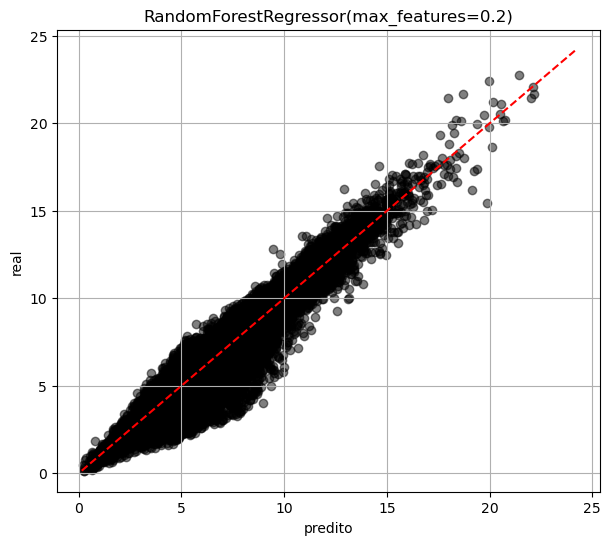

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_01[features].values
y = df_01[target].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)

y_pred = lin_reg.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '01_LR_tts','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y_test, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\567607947.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '01_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR


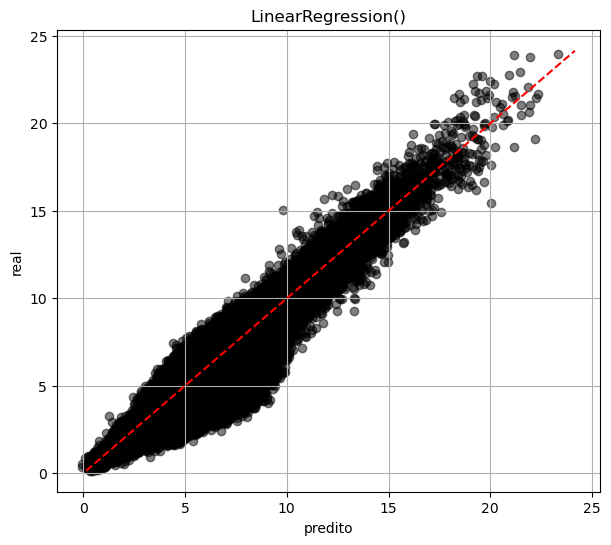

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_01[features].values
y = df_01[target].values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '01_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\3019832473.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '01_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF


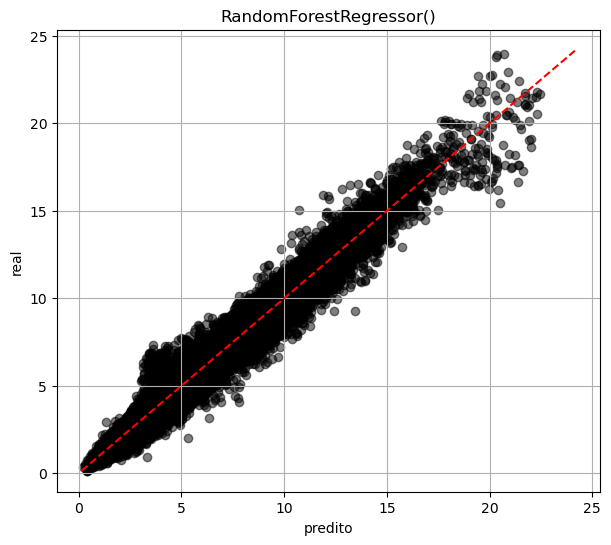

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_01[features].values
y = df_01[target].values

model = RandomForestRegressor()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '01_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

## Versão 2

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\4114338104.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '02_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR


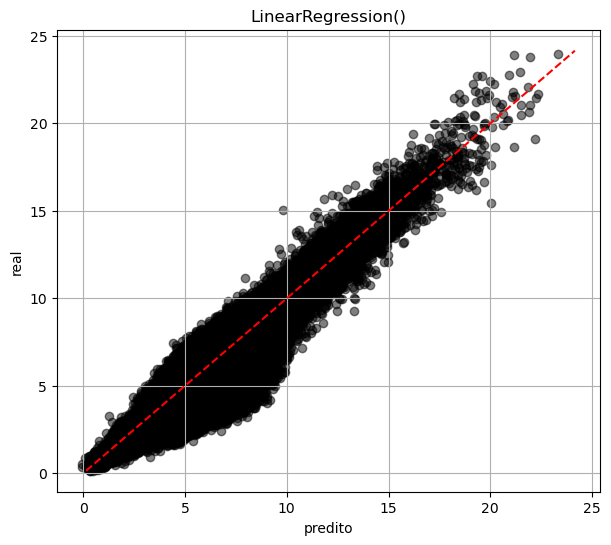

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_02_nanout[features].values
y = df_02_nanout[target].values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '02_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\2683679625.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '02_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR
4 0.356256 0.236780 0.486601 0.971800      02_RF


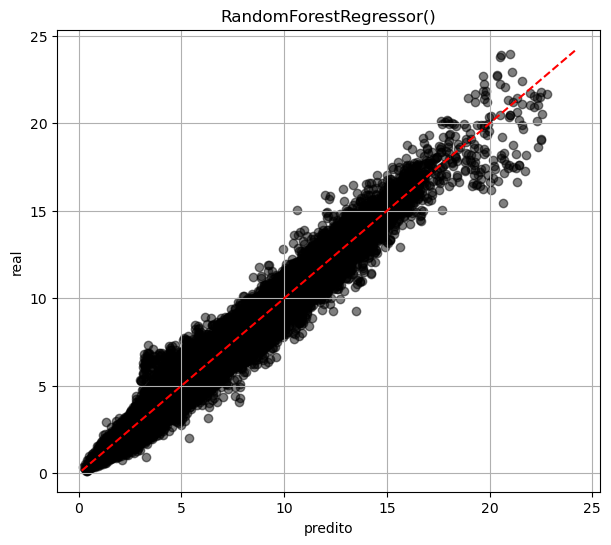

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_02_nanout[features].values
y = df_02_nanout[target].values

model = RandomForestRegressor()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '02_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

## Versão 3

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\3907621054.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '03_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR
4 0.356256 0.236780 0.486601 0.971800      02_RF
5 0.539000 0.590995 0.768762 0.927531      03_LR


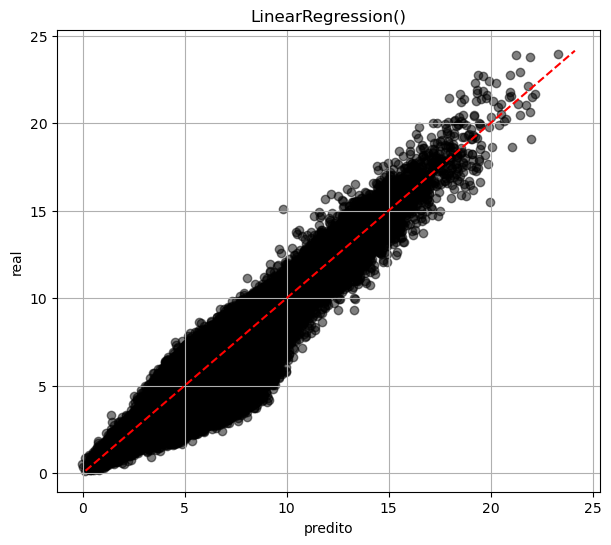

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

data = df_03

X = data[features].values
y = data[target].values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '03_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\912162776.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '03_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR
4 0.356256 0.236780 0.486601 0.971800      02_RF
5 0.539000 0.590995 0.768762 0.927531      03_LR
6 0.349327 0.223857 0.473136 0.972550      03_RF


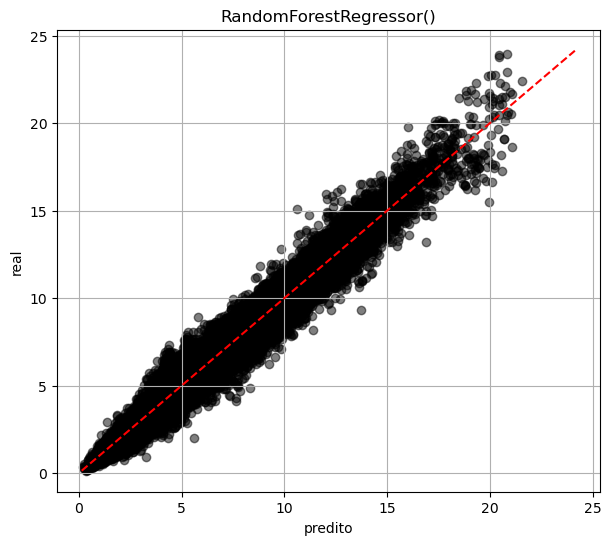

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

data = df_03

X = data[features].values
y = data[target].values

model = RandomForestRegressor()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '03_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

## Versão 4

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\2363846722.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '04_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR
4 0.356256 0.236780 0.486601 0.971800      02_RF
5 0.539000 0.590995 0.768762 0.927531      03_LR
6 0.349327 0.223857 0.473136 0.972550      03_RF
7 0.539000 0.590995 0.768762 0.927531      04_LR


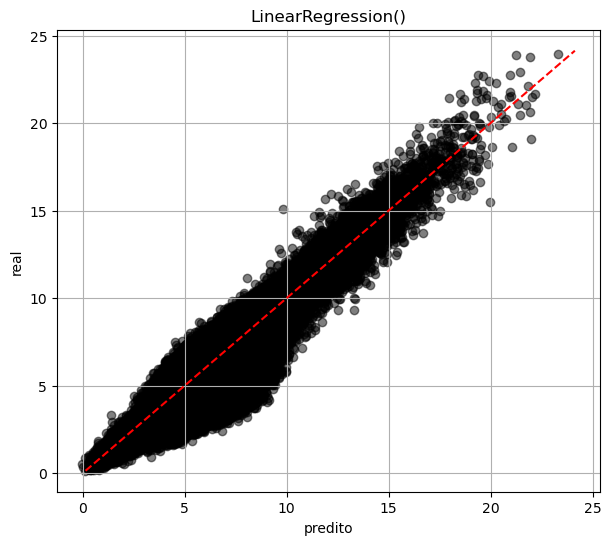

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_04_features.values
y = df_04_target.values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

y_pred_gd_inv = min_max_scaler_y.inverse_transform(y_pred.reshape(-1, 1))


y = np.array(df_03[target])
y_pred = y_pred_gd_inv


mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '04_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\108492279.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '04_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR
4 0.356256 0.236780 0.486601 0.971800      02_RF
5 0.539000 0.590995 0.768762 0.927531      03_LR
6 0.349327 0.223857 0.473136 0.972550      03_RF
7 0.539000 0.590995 0.768762 0.927531      04_LR
8 0.349694 0.224587 0.473906 0.972461      04_RF


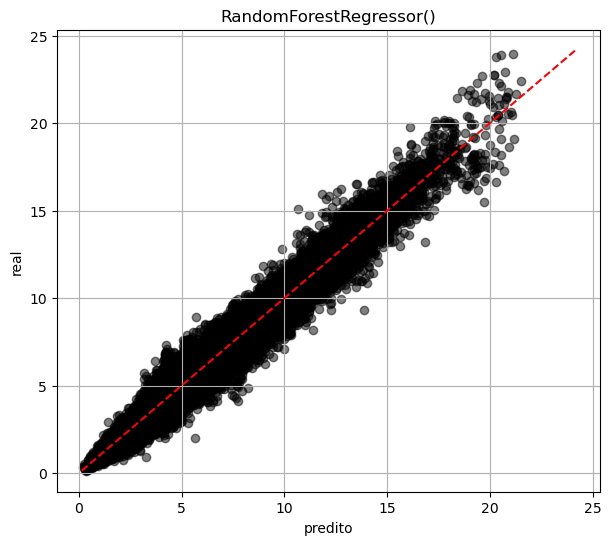

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_04_features.values
y = df_04_target.values

model = RandomForestRegressor()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

y_pred_gd_inv = min_max_scaler_y.inverse_transform(y_pred.reshape(-1, 1))

y = np.array(df_03[target])
y_pred = y_pred_gd_inv

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '04_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

## Versão 5

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\1523702599.py:26: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '05_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


       MAE      MSE     RMSE       R2     VERSAO
0 0.537439 0.586655 0.765934 0.928514  01_LR_tts
1 0.550072 0.615694 0.784662 0.926673      01_LR
2 0.356533 0.236713 0.486532 0.971808      01_RF
3 0.550109 0.615713 0.784674 0.926671      02_LR
4 0.356256 0.236780 0.486601 0.971800      02_RF
5 0.539000 0.590995 0.768762 0.927531      03_LR
6 0.349327 0.223857 0.473136 0.972550      03_RF
7 0.539000 0.590995 0.768762 0.927531      04_LR
8 0.349694 0.224587 0.473906 0.972461      04_RF
9 0.540498 0.595116 0.771438 0.927026      05_LR


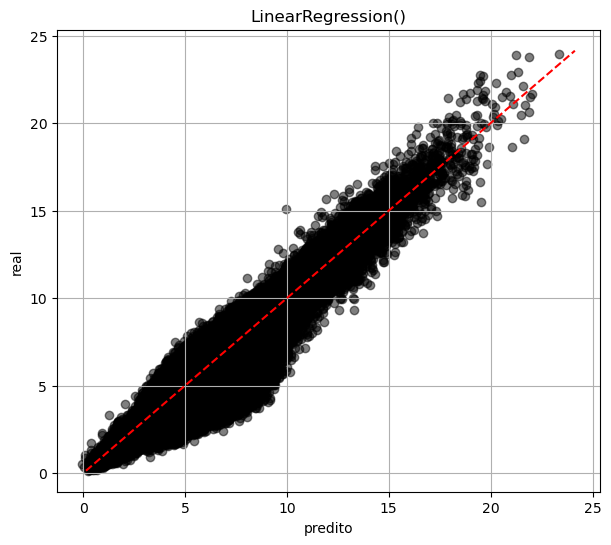

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_05_features.values
y = df_05_target.values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

y_pred_gd_inv = rob_scaler_y.inverse_transform(y_pred.reshape(-1, 1))


y = np.array(df_03[target])
y_pred = y_pred_gd_inv


mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '05_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\2274577113.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '05_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


        MAE      MSE     RMSE       R2     VERSAO
0  0.537439 0.586655 0.765934 0.928514  01_LR_tts
1  0.550072 0.615694 0.784662 0.926673      01_LR
2  0.356533 0.236713 0.486532 0.971808      01_RF
3  0.550109 0.615713 0.784674 0.926671      02_LR
4  0.356256 0.236780 0.486601 0.971800      02_RF
5  0.539000 0.590995 0.768762 0.927531      03_LR
6  0.349327 0.223857 0.473136 0.972550      03_RF
7  0.539000 0.590995 0.768762 0.927531      04_LR
8  0.349694 0.224587 0.473906 0.972461      04_RF
9  0.540498 0.595116 0.771438 0.927026      05_LR
10 0.349510 0.224006 0.473292 0.972532      05_RF


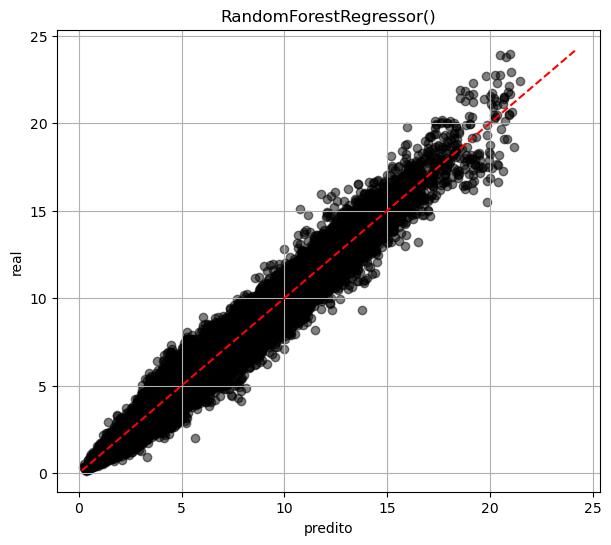

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

X = df_05_features.values
y = df_05_target.values

model = RandomForestRegressor()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

y_pred_gd_inv = rob_scaler_y.inverse_transform(y_pred.reshape(-1, 1))

y = np.array(df_03[target])
y_pred = y_pred_gd_inv

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '05_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

## Versão 6

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\4277753083.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '06_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


        MAE      MSE     RMSE       R2     VERSAO
0  0.537439 0.586655 0.765934 0.928514  01_LR_tts
1  0.550072 0.615694 0.784662 0.926673      01_LR
2  0.356533 0.236713 0.486532 0.971808      01_RF
3  0.550109 0.615713 0.784674 0.926671      02_LR
4  0.356256 0.236780 0.486601 0.971800      02_RF
5  0.539000 0.590995 0.768762 0.927531      03_LR
6  0.349327 0.223857 0.473136 0.972550      03_RF
7  0.539000 0.590995 0.768762 0.927531      04_LR
8  0.349694 0.224587 0.473906 0.972461      04_RF
9  0.540498 0.595116 0.771438 0.927026      05_LR
10 0.349510 0.224006 0.473292 0.972532      05_RF
11 0.538563 0.618131 0.786213 0.924204      06_LR


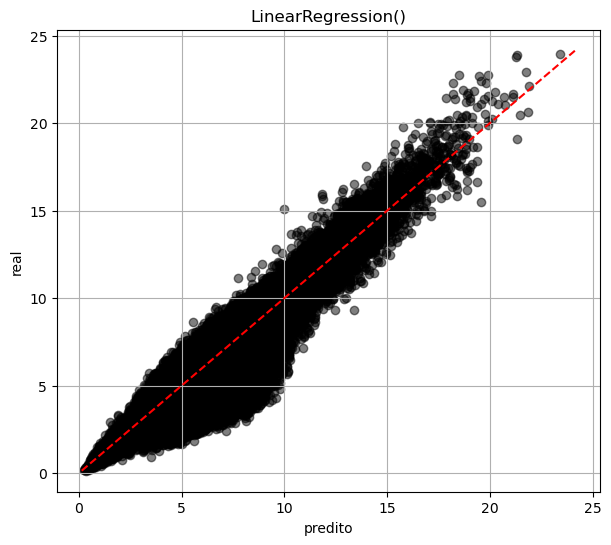

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = features_selected

data = df_06

X = data[features].values
y = data[target].values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '06_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\377255961.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '06_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


        MAE      MSE     RMSE       R2     VERSAO
0  0.537439 0.586655 0.765934 0.928514  01_LR_tts
1  0.550072 0.615694 0.784662 0.926673      01_LR
2  0.356533 0.236713 0.486532 0.971808      01_RF
3  0.550109 0.615713 0.784674 0.926671      02_LR
4  0.356256 0.236780 0.486601 0.971800      02_RF
5  0.539000 0.590995 0.768762 0.927531      03_LR
6  0.349327 0.223857 0.473136 0.972550      03_RF
7  0.539000 0.590995 0.768762 0.927531      04_LR
8  0.349694 0.224587 0.473906 0.972461      04_RF
9  0.540498 0.595116 0.771438 0.927026      05_LR
10 0.349510 0.224006 0.473292 0.972532      05_RF
11 0.538563 0.618131 0.786213 0.924204      06_LR
12 0.506507 0.521719 0.722301 0.936026      06_RF


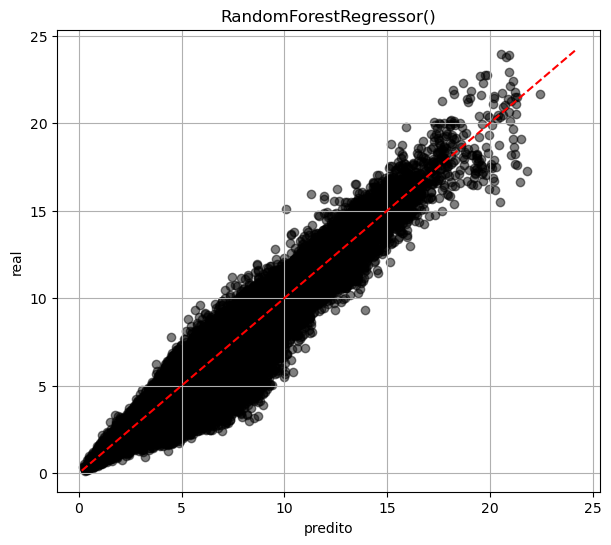

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = features_selected

data = df_06

X = data[features].values
y = data[target].values

model = RandomForestRegressor()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '06_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

## Versão 7 - Ajuste de hiperparâmetros

In [ ]:
X = df_03[features].values
y = df_03[target].values


hiperparametros = {'copy_X': [True,False],
               'fit_intercept': [True,False],
               'positive': [True,False]}

rand_search = RandomizedSearchCV(LinearRegression(),
                                 hiperparametros,
                                 n_iter=8, n_jobs=-1, cv=4,
                                 scoring='neg_mean_absolute_error')


rand_search.fit(X, y)

RandomizedSearchCV(cv=4, estimator=LinearRegression(), n_iter=8, n_jobs=-1,
                   param_distributions={'copy_X': [True, False],
                                        'fit_intercept': [True, False],
                                        'positive': [True, False]},
                   scoring='neg_mean_absolute_error')

In [ ]:
rand_search.best_params_

{'positive': True, 'fit_intercept': True, 'copy_X': True}

In [ ]:
df_rand = pd.DataFrame(rand_search.cv_results_)

df_rand.sort_values(by='mean_test_score', ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_positive,param_fit_intercept,param_copy_X,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.158779,0.033994,0.006004,0.001735,True,True,True,"{'positive': True, 'fit_intercept': True, 'cop...",-0.586365,-0.535792,-0.512509,-0.515405,-0.537518,0.029595,1
4,0.190042,0.040758,0.009507,0.002066,True,True,False,"{'positive': True, 'fit_intercept': True, 'cop...",-0.586365,-0.535792,-0.512509,-0.515405,-0.537518,0.029595,1
2,0.119524,0.016771,0.012506,0.001118,True,False,True,"{'positive': True, 'fit_intercept': False, 'co...",-0.588337,-0.537657,-0.513697,-0.514153,-0.538461,0.030382,3
6,0.097525,0.010410,0.008503,0.002061,True,False,False,"{'positive': True, 'fit_intercept': False, 'co...",-0.588337,-0.537657,-0.513697,-0.514153,-0.538461,0.030382,3
1,0.211675,0.029059,0.006002,0.001582,False,True,True,"{'positive': False, 'fit_intercept': True, 'co...",-0.585955,-0.535598,-0.511618,-0.521080,-0.538563,0.028664,5
5,0.210543,0.051215,0.007506,0.002596,False,True,False,"{'positive': False, 'fit_intercept': True, 'co...",-0.585955,-0.535598,-0.511618,-0.521080,-0.538563,0.028664,5
3,0.167535,0.024205,0.009502,0.003906,False,False,True,"{'positive': False, 'fit_intercept': False, 'c...",-0.587273,-0.536863,-0.512399,-0.521124,-0.539415,0.028988,7
7,0.142530,0.007829,0.005752,0.001091,False,False,False,"{'positive': False, 'fit_intercept': False, 'c...",-0.587273,-0.536863,-0.512399,-0.521124,-0.539415,0.028988,7


In [ ]:
best_lr = rand_search.best_params_
best_lr

{'positive': True, 'fit_intercept': True, 'copy_X': True}

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

data = df_03

X = data[features].values
y = data[target].values

model = LinearRegression()
model.set_params(**best_lr)

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)


C:\Users\terce\AppData\Local\Temp\ipykernel_21360\93920639.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '07_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


        MAE      MSE     RMSE       R2     VERSAO
0  0.537439 0.586655 0.765934 0.928514  01_LR_tts
1  0.550072 0.615694 0.784662 0.926673      01_LR
2  0.356533 0.236713 0.486532 0.971808      01_RF
3  0.550109 0.615713 0.784674 0.926671      02_LR
4  0.356256 0.236780 0.486601 0.971800      02_RF
5  0.539000 0.590995 0.768762 0.927531      03_LR
6  0.349327 0.223857 0.473136 0.972550      03_RF
7  0.539000 0.590995 0.768762 0.927531      04_LR
8  0.349694 0.224587 0.473906 0.972461      04_RF
9  0.540498 0.595116 0.771438 0.927026      05_LR
10 0.349510 0.224006 0.473292 0.972532      05_RF
11 0.538563 0.618131 0.786213 0.924204      06_LR
12 0.506507 0.521719 0.722301 0.936026      06_RF
13 0.538754 0.594902 0.771299 0.927052      07_LR


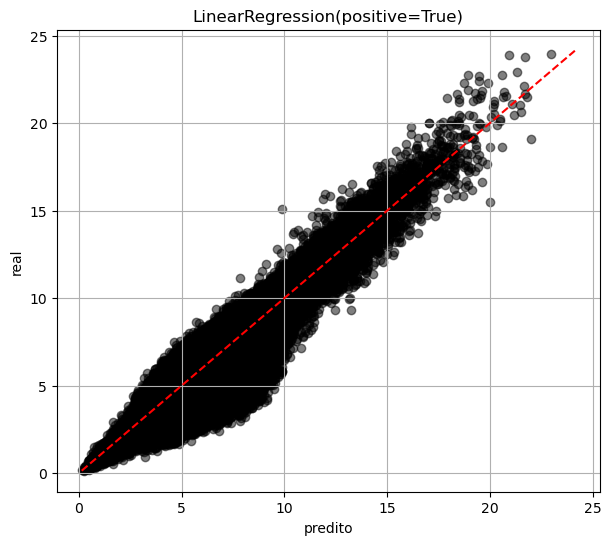

In [ ]:
# # Coluna target
# # target = ['target_feature'] # Já está definida!

# # Colunas features
# features = df_columns_num + df_columns_temp_int

# X = df_04_features.values
# y = df_04_target.values

# model = LinearRegression()

# model.set_params(**best_lr)

# y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

# y_pred_gd_inv = min_max_scaler_y.inverse_transform(y_pred.reshape(-1, 1))


# y = np.array(df_03[target])
# y_pred = y_pred_gd_inv


mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '07_LR','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

In [ ]:
features = df_columns_num + df_columns_temp_int

data = df_03

X = data[features].values
y = data[target].values


hiperparametros = {
    'n_estimators': [10, 50, 100],
    'max_depth': [10, 50, None],
    'max_features': [0.2, 0.5, 0.8]
}

rand_search = RandomizedSearchCV(RandomForestRegressor(),
                                 hiperparametros,
                                 n_iter=8, n_jobs=-1,
                                 scoring='neg_mean_absolute_error')


rand_search.fit(X, y)

c:\Users\terce\anaconda3\envs\unifor\lib\site-packages\sklearn\model_selection\_search.py:910: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


RandomizedSearchCV(estimator=RandomForestRegressor(), n_iter=8, n_jobs=-1,
                   param_distributions={'max_depth': [10, 50, None],
                                        'max_features': [0.2, 0.5, 0.8],
                                        'n_estimators': [10, 50, 100]},
                   scoring='neg_mean_absolute_error')

In [ ]:
rand_search.best_params_

{'n_estimators': 100, 'max_features': 0.5, 'max_depth': None}

In [ ]:
df_rand = pd.DataFrame(rand_search.cv_results_)

df_rand.sort_values(by='mean_test_score', ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_max_features,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
3,727.407504,6.834291,1.880845,0.262263,100,0.500000,None,"{'n_estimators': 100, 'max_features': 0.5, 'ma...",-0.371637,-0.320645,-0.343075,-0.341245,-0.343701,-0.344061,0.016235,1
1,717.670344,23.707633,2.438565,0.264867,100,0.500000,50,"{'n_estimators': 100, 'max_features': 0.5, 'ma...",-0.372233,-0.319533,-0.343554,-0.341864,-0.343285,-0.344094,0.016739,2
4,368.138958,17.995598,1.392959,0.324233,50,0.500000,50,"{'n_estimators': 50, 'max_features': 0.5, 'max...",-0.375093,-0.323094,-0.344215,-0.344465,-0.343878,-0.346149,0.016620,3
2,151.259123,5.850277,1.172219,0.080167,50,0.200000,None,"{'n_estimators': 50, 'max_features': 0.2, 'max...",-0.376150,-0.322712,-0.344580,-0.341910,-0.351387,-0.347348,0.017263,4
5,230.002869,13.103324,0.292421,0.025060,50,0.500000,10,"{'n_estimators': 50, 'max_features': 0.5, 'max...",-0.408233,-0.351951,-0.379546,-0.373529,-0.375066,-0.377665,0.018017,5
7,236.105209,13.166743,0.121350,0.020226,50,0.800000,10,"{'n_estimators': 50, 'max_features': 0.8, 'max...",-0.411304,-0.354043,-0.380197,-0.375203,-0.381192,-0.380388,0.018316,6
6,47.053610,0.748200,0.066213,0.007886,10,0.500000,10,"{'n_estimators': 10, 'max_features': 0.5, 'max...",-0.414838,-0.356266,-0.385725,-0.381173,-0.384560,-0.384512,0.018602,7
0,72.938999,3.074365,0.071417,0.015922,10,0.800000,10,"{'n_estimators': 10, 'max_features': 0.8, 'max...",-0.417551,-0.361874,-0.384921,-0.382644,-0.394034,-0.388205,0.018057,8


In [ ]:
best_rf = rand_search.best_params_
best_rf

{'n_estimators': 100, 'max_features': 0.5, 'max_depth': None}

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

data = df_03

X = data[features].values
y = data[target].values

model = RandomForestRegressor()
model.set_params(**best_rf)

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

C:\Users\terce\AppData\Local\Temp\ipykernel_21360\3501341404.py:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_comparacao = df_comparacao.append({'VERSAO': '07_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)


        MAE      MSE     RMSE       R2     VERSAO
0  0.537439 0.586655 0.765934 0.928514  01_LR_tts
1  0.550072 0.615694 0.784662 0.926673      01_LR
2  0.356533 0.236713 0.486532 0.971808      01_RF
3  0.550109 0.615713 0.784674 0.926671      02_LR
4  0.356256 0.236780 0.486601 0.971800      02_RF
5  0.539000 0.590995 0.768762 0.927531      03_LR
6  0.349327 0.223857 0.473136 0.972550      03_RF
7  0.539000 0.590995 0.768762 0.927531      04_LR
8  0.349694 0.224587 0.473906 0.972461      04_RF
9  0.540498 0.595116 0.771438 0.927026      05_LR
10 0.349510 0.224006 0.473292 0.972532      05_RF
11 0.538563 0.618131 0.786213 0.924204      06_LR
12 0.506507 0.521719 0.722301 0.936026      06_RF
13 0.538754 0.594902 0.771299 0.927052      07_LR
14 0.343876 0.214120 0.462730 0.973744      07_RF


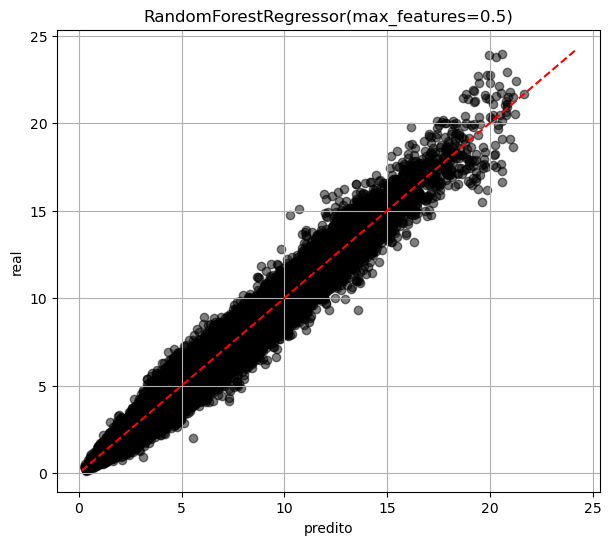

In [ ]:
# # Coluna target
# # target = ['target_feature'] # Já está definida!

# # Colunas features
# features = df_columns_num + df_columns_temp_int

# X = df_04_features.values
# y = df_04_target.values

# model = RandomForestRegressor()
# model.set_params(**best_rf)

# y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

# y_pred_gd_inv = min_max_scaler_y.inverse_transform(y_pred.reshape(-1, 1))

# y = np.array(df_03[target])
# y_pred = y_pred_gd_inv

# mae = mean_absolute_error(y, y_pred)
# mse = mean_squared_error(y, y_pred)
# rmse = np.sqrt(mse)
# r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'VERSAO': '07_RF','MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(model)
plt.grid()
plt.show()

# 7. Avaliação do Modelo e Conclusão

## Métricas utilizadas

In [ ]:
df_comparacao.sort_values(by='MAE', ascending=True)

,MAE,MSE,RMSE,R2,VERSAO
14,0.343876,0.214120,0.462730,0.973744,07_RF
6,0.349327,0.223857,0.473136,0.972550,03_RF
10,0.349510,0.224006,0.473292,0.972532,05_RF
8,0.349694,0.224587,0.473906,0.972461,04_RF
4,0.356256,0.236780,0.486601,0.971800,02_RF
2,0.356533,0.236713,0.486532,0.971808,01_RF
12,0.506507,0.521719,0.722301,0.936026,06_RF
0,0.537439,0.586655,0.765934,0.928514,01_LR_tts
11,0.538563,0.618131,0.786213,0.924204,06_LR
13,0.538754,0.594902,0.771299,0.927052,07_LR


Entre os modelos testados, Random Forest fica melhor para o caso, pois apesar de termos veriáveis correlacionádas linearmente com o taget, o dataset possui muitas outras categorias com comportamento não linear em relação ao target.

## Melhorias e ajustes futuros

- Aprofundamento na limpeza de outliers;
- Ajustes para tornar as distribuiçoes simétricas;
- Verificar outra estratégia para tratar os dados ausentes;
- Buscar combinações de atributos;




## Conclusão

O modelo atende o objetivo.

# Aplicando no dataset de teste

In [ ]:
df_teste_bk = df_teste.copy()

In [ ]:
# Criar Colunas mês e ano
mes=[]
ano=[]
for i in range(len(df_teste)):
    mes.append(df_teste['Timestamp'].iloc[i].month)
    ano.append(df_teste['Timestamp'].iloc[i].year)
df_teste['MES']=mes
df_teste['ANO']=ano

In [ ]:
# Retirando do df as linhas com valores ausentes em qualquer coluna fora as colunas que possuem mais de 2000 registros ausentes.
df_nan = nan_verification(df_teste[df_columns_num])

list_base_nan = list(df_nan[df_nan['Count'] > 2000].index)
list_base_compl = list(df_nan[df_nan['Count'] <= 2000].index)

df_03_teste  = df_teste[~df_teste[list_base_compl].isna().any(axis=1)].copy()
nan_verification(df_03_teste)

,Count,Perc
Generator RPM (RPM).1,14419,22.816317
Vane position 1+2 (°).1,14419,22.816317
Power (kW).1,14419,22.816317
Blade angle (pitch position) A (°).1,14419,22.816317
Nacelle ambient temperature (°C).1,14419,22.816317
Nacelle position (°).1,14418,22.814735
Wind speed (m/s).1,14418,22.814735
"Wind speed, Standard deviation (m/s).1",14418,22.814735
"Nacelle position, Standard deviation (°).1",14418,22.814735
Wind direction (°).1,14418,22.814735


In [ ]:
# Aplicando o preenchimento
data = df_03_teste # Mudar para  Dataset de referência

for i in list_base_nan:
    mask_null = data[i].isna()
    X_fill = data[list_base_compl][~mask_null].values
    y_fill = data[i][~mask_null].values

    lr_fill = LinearRegression()
    lr_fill.fit(X_fill, y_fill)

    X_fill2 = data[mask_null][list_base_compl].values
    X_fill2
    y_pred_fill2 = lr_fill.predict(X_fill2)

    data.loc[data[mask_null].index, i] = y_pred_fill2

    data[mask_null]

In [ ]:
nan_verification(df_03_teste)

,Count,Perc
Timestamp,0,0.000000
Vane position 1+2 (°).1,0,0.000000
Vane position 1+2 (°).3,0,0.000000
Vane position 1+2 (°).4,0,0.000000
Power (kW),0,0.000000
Power (kW).1,0,0.000000
Power (kW).2,0,0.000000
Power (kW).3,0,0.000000
Power (kW).4,0,0.000000
Nacelle ambient temperature (°C),0,0.000000


In [ ]:
features = df_columns_num + df_columns_temp_int

data = df_03

X = data[features].values
y = data[target].values

model = RandomForestRegressor()
model.set_params(**best_rf)
model.fit(X_train, y_train)

y_pred = model.predict(df_03_teste[features])

In [ ]:
y_pred

array([8.30996422, 8.71855094, 8.82614111, ..., 5.14144871, 5.31708105,
       5.43985842])

In [ ]:
len(y_pred)

63196

In [ ]:
df_03_teste.index

Index(['2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024',
       '2025',
       ...
       193526, 193527, 193528, 193529, 193530, 193531, 193532, 193533, 193534,
       193535],
      dtype='object', name='id', length=63196)

In [ ]:
len(df_03_teste.index)

63196

In [ ]:
df_y_pred = pd.DataFrame(y_pred,columns=target)
df_y_pred['id'] = df_03_teste.index
df_y_pred

,target_feature,id
0,8.309964,2016
1,8.718551,2017
2,8.826141,2018
3,8.217944,2019
4,7.430629,2020
...,...,...
63191,5.499988,193531
63192,5.157911,193532
63193,5.141449,193533
63194,5.317081,193534


In [ ]:
df_teste_bk[~(df_teste_bk.index.isin(df_y_pred['id']))]

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
17710,2018-01-31 23:40:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17725,2018-02-01 02:10:00,8.480155,NaN,NaN,6.202165,NaN,0.000000,NaN,NaN,0.000000,NaN,292.548126,NaN,NaN,288.421692,NaN,282.315643,NaN,NaN,282.903534,NaN,0.000000,NaN,NaN,0.000000,NaN,9.727406,14.482511,NaN,-1.430385,NaN,1151.418213,NaN,NaN,529.435486,NaN,3.400000,NaN,NaN,2.800000,NaN,1774.406250,NaN,NaN,1380.567505,NaN,0.000000,NaN,NaN,0.000000,NaN
23676,2018-03-14 10:00:00,NaN,8.504097,8.060308,8.030999,7.584658,NaN,1.224340,0.990827,0.898877,1.142025,NaN,149.292877,147.958099,144.977188,144.785965,NaN,149.388519,143.341461,142.414703,142.626022,NaN,0.000000,0.000000,0.000000,1.196043,NaN,1.450482,2.830728,4.386706,8.540563,NaN,1233.711548,1118.916382,1151.858398,1020.742554,NaN,7.460000,7.872500,6.987500,8.180000,NaN,1737.952271,1723.431763,1712.499390,1684.708984,NaN,0.006000,0.000000,0.032999,0.000000
23677,2018-03-14 10:10:00,NaN,8.172360,9.183131,8.716802,8.298136,NaN,1.343829,1.207597,0.999587,1.142749,NaN,154.035156,143.516571,148.188339,150.138504,NaN,149.388519,143.341461,142.414703,142.900055,NaN,0.000000,0.000000,0.000000,0.000000,NaN,3.762136,3.845105,0.381431,5.479430,NaN,1147.344116,1380.717529,1396.978638,1260.371582,NaN,7.895000,8.309999,7.447500,8.595000,NaN,1676.698730,1742.416260,1771.463013,1739.584595,NaN,0.149967,0.212476,0.069994,0.204443
23678,2018-03-14 10:20:00,NaN,8.289565,7.567183,9.143283,8.633593,NaN,0.911056,1.607977,1.128306,1.102576,NaN,149.577866,148.126099,144.541534,144.868240,NaN,149.388519,143.341461,142.414703,142.900055,NaN,0.000000,0.000000,0.000000,0.000000,NaN,-1.993103,5.931244,1.381804,2.156294,NaN,1227.950928,952.333923,1560.530151,1410.296143,NaN,8.127501,8.620000,7.685000,8.812500,NaN,1749.412842,1605.002563,1779.469849,1760.394287,NaN,0.000000,0.039999,0.338450,0.078499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190317,2021-05-14 15:30:00,1.243706,0.843099,NaN,0.808835,0.958988,0.458454,0.361976,NaN,0.427919,0.485003,203.114988,226.754943,NaN,282.170592,232.727248,28.777212,266.824615,NaN,19.489151,10.093342,0.000000,0.000000,NaN,0.000000,0.000000,35.621506,-40.297141,NaN,-88.782805,-55.588172,-0.654605,-1.642647,NaN,-1.959546,-1.747746,13.215000,13.426316,NaN,12.905263,13.352

In [ ]:
index_fora = list(df_teste_bk[~(df_teste_bk.index.isin(df_y_pred['id']))].index)
index_fora

['17710',
 '17725',
 '23676',
 '23677',
 '23678',
 '23688',
 '23689',
 '23701',
 '23702',
 '23707',
 '23708',
 '35753',
 '35781',
 '35785',
 '35786',
 '35787',
 '35788',
 '35789',
 '35790',
 '35791',
 '35792',
 '35793',
 '35794',
 '35795',
 '35796',
 '44610',
 '44611',
 53706,
 53707,
 53708,
 53709,
 53710,
 53711,
 53712,
 53713,
 53714,
 53715,
 53716,
 53717,
 53718,
 53719,
 53720,
 53721,
 53722,
 53723,
 53724,
 53725,
 53726,
 53727,
 53728,
 53729,
 53730,
 53731,
 53732,
 53733,
 53734,
 53735,
 53736,
 53737,
 53738,
 53739,
 53740,
 53741,
 53742,
 53743,
 53744,
 53745,
 53746,
 53747,
 53748,
 53749,
 53750,
 53751,
 53752,
 53753,
 53754,
 53755,
 53756,
 53757,
 53758,
 53909,
 53910,
 53911,
 53912,
 53913,
 53914,
 53915,
 53916,
 53917,
 53918,
 53919,
 53920,
 53921,
 53922,
 53923,
 53924,
 53925,
 53926,
 53927,
 53928,
 53929,
 53930,
 53931,
 53932,
 53933,
 53934,
 53935,
 53936,
 53937,
 53938,
 56448,
 56449,
 56450,
 56451,
 56452,
 56453,
 56454,
 56455,
 5

In [ ]:
df_incluir = pd.DataFrame()
df_incluir['id'] = index_fora

df_incluir[target] = df_y_pred[target].mean()
df_incluir

,id,target_feature
0,17710,6.113283
1,17725,6.113283
2,23676,6.113283
3,23677,6.113283
4,23678,6.113283
...,...,...
1311,190317,6.113283
1312,190318,6.113283
1313,190319,6.113283
1314,190320,6.113283


In [ ]:
df_03_teste[target] = df_y_pred[target]
df_03_teste

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,MES,ANO,target_feature
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016,2017-10-15 00:00:00,9.410975,8.906447,8.516111,6.889416,7.907523,0.827754,0.760050,0.453254,0.971320,0.582650,178.745422,179.390518,175.677658,172.028931,172.898300,168.169586,175.730316,179.561615,166.561676,175.827789,0.000000,0.000000,0.000000,0.000000,0.000000,9.813562,1.023784,-4.427249,9.815627,-1.874476,1504.308472,1255.058228,1082.256226,700.878479,902.565918,13.940000,13.590000,13.977500,13.155000,14.235000,1794.619385,1792.041626,1737.601440,1528.941040,1653.416992,0.007500,0.000000,0.000000,0.000000,0.000000,10,2017,NaN
2017,2017-10-15 00:10:00,9.313236,9.432560,9.133708,6.192321,8.215790,1.074361,0.898349,0.532972,0.964311,0.389154,180.858505,181.232010,177.872070,179.674606,178.441376,175.088364,175.730316,179.561615,170.273499,175.827789,4.526708,0.000000,0.000000,3.752413,0.000000,3.500461,5.471499,-4.201434,11.366840,1.854400,1587.863037,1594.518921,1477.232178,565.278809,1039.823242,13.750000,13.470000,13.912499,12.990000,14.179999,1794.245117,1795.033936,1789.427734,1420.354858,1730.603027,0.000000,0.000000,0.000000,0.000000,0.000000,10,2017,NaN
2018,2017-10-15 00:20:00,9.726503,9.917058,9.376414,6.014155,8.579673,0.937988,0.602810,0.519404,0.720272,0.614934,181.465973,185.406296,179.665298,187.005249,179.462784,178.047668,176.493790,179.561615,174.244629,175.827789,0.000000,2.885159,0.000000,0.000000,0.000000,5.362266,8.677570,0.023239,8.275834,3.696539,1576.585693,1593.103882,1502.943237,505.548157,1122.550903,13.485000,13.235000,13.730000,12.907499,14.007500,1796.775269,1795.225830,1789.707031,1382.760376,1764.003418,0.031500,0.000000,0.000000,0.000000,0.000000,10,2017,NaN
2019,2017-10-15 00:30:00,8.560906,9.248798,8.932862,5.859115,8.805655,0.596583,0.797295,0.686779,0.861738,0.532247,183.514374,181.969666,182.748886,181.574265,180.827240,178.047668,188.901093,179.561615,174.244629,175.827789,0.000000,0.000000,0.000000,0.000000,0.000000,6.853310,-6.322511,3.070251,10.137497,4.278877,1215.635864,1376.486206,1323.369751,495.390717,1218.303589,13.227500,12.990000,13.332500,12.797501,13.822500,1776.527100,1787.640747,1790.412354,1374.962036,1789.303711,0.000000,0.000000,0.000000,0.000000,0.000000,10,2017,NaN
2020,2017-10-15 00:40:00,7.590319,8.011730,8.251603,5.712709,7.929028,0.559754,0.656621,0.609038,0.825590,0.576971,188.070450,185.820969,189.125854,192.836639,185.543381,184.931595,188.901093,179.561615,174.244629,177.372955,5.829193,0.000000,0.000000,0.000000,4.006085,2.999528,-4.212601,9.962421,20.578293,7.823682,937.587585,1020.575012,1073.293457,465.3874

In [ ]:
df_03_teste


In [ ]:
target

['target_feature']

In [ ]:
# Juntar verticalmente
df_teste_final = pd.concat([df_y_pred[['id','target_feature']], df_incluir], ignore_index=True)
df_teste_final

,id,target_feature
0,2016,8.309964
1,2017,8.718551
2,2018,8.826141
3,2019,8.217944
4,2020,7.430629
...,...,...
64507,190317,6.113283
64508,190318,6.113283
64509,190319,6.113283
64510,190320,6.113283


In [ ]:
# Exportar o DataFrame para CSV
df_teste_final.to_csv("df_final.csv", index=False)  # index=False remove o índice do arquivo

# FIM

Analisando as distribuiçõe: tornando-as simétricas log ou exp (se possível) e realizando agrupamentos  

Distribuição Log-normal: Quando uma variável é o resultado de uma multiplicação de muitos fatores pequenos positivos (como a velocidade do vento, que não pode ser negativa), ela tende a seguir uma distribuição log-normal. Esta distribuição é assimétrica à direita e é comum em variáveis ambientais.

In [ ]:
df_columns_wind = ['Wind speed (m/s)',
 'Wind speed (m/s).1',
 'Wind speed (m/s).2',
 'Wind speed (m/s).3',
 'Wind speed (m/s).4',
 'Wind speed, Standard deviation (m/s)',
 'Wind speed, Standard deviation (m/s).1',
 'Wind speed, Standard deviation (m/s).2',
 'Wind speed, Standard deviation (m/s).3',
 'Wind speed, Standard deviation (m/s).4']

In [ ]:
df_06 = df_03.copy()

for i in df_columns_wind:
    # Adicionar uma constante para tornar os valores positivos
    constante = abs(df_06[i].min()) + 1  # Garante que o menor valor seja > 0
    df_06[i] = df_06[i] + constante

# Adicionar uma constante para tornar os valores positivos
constante_y = abs(df_06[target].min()) + 1  # Garante que o menor valor seja > 0
df_06_target = df[target] + constante_y



df_06[df_columns_wind] = np.log(df_06[df_columns_wind])
df_06_target = np.log(df_06[target]) # Para cálcular o inverso np.exp(np.log(x))

In [ ]:
# Coluna target
# target = ['target_feature'] # Já está definida!

# Colunas features
features = df_columns_num + df_columns_temp_int

data = df_06

X = data[features].values
y = df_06_target.values

model = LinearRegression()

y_pred = cross_val_predict(model, X, y, cv=4, n_jobs=-1)

y = np.array(df_06[target])
y_pred = pd.DataFrame(np.exp(y_pred), columns = target) - constante_y

mae = mean_absolute_error(y, y_pred)
mse = mean_squared_error(y, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y, y_pred)

df_comparacao = df_comparacao.append({'MAE':mae, 'MSE':mse, 'RMSE':rmse, 'R2':r2},ignore_index=True)
print(df_comparacao)

# Plot
xy_plot = np.arange(min(y), max(y)+1)

plt.figure(figsize=(7,6))
plt.scatter(y_pred, y, color='black', alpha=0.5)
plt.plot(xy_plot, xy_plot, '--r')
plt.xlabel('predito')
plt.ylabel('real')
plt.title(lin_reg)
plt.grid()
plt.show()